In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
sc.set_figure_params(figsize=(8,8), fontsize=15, )
import random
import numpy as np
from numpy import linalg as LA
from FACS_Sampling.preprocessing.utils import create_adata, read_tcell
from FACS_Sampling.methods.methods import sample_random, bin_sample, proportional_sampling, dist_sampling
from FACS_Sampling.plotting.plotting import change_cmap

import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
adata = sc.read_h5ad("../../FACS_Sampling/datasets/healty_schayan.h5ad")

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(


In [4]:
labels = pd.read_csv("../../FACS_Sampling/datasets/labels.csv")
from operator import methodcaller
labels_ = list(map(methodcaller("split", ";"), labels[';"x"']))
labels = [labels_[i][1] for i in range(len(labels_))]
labels = [labels[i].split("\"")[1] for i in range(len(labels))]

In [5]:
adata.obs['labels'] = labels

In [6]:
adata

AnnData object with n_obs × n_vars = 30000 × 39
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Patient', 'FlowSOM_cluster', 'FlowSOM_metacluster', 'RNA_snn_res.0.2', 'RNA_snn_res.0.4', 'RNA_snn_res.0.6', 'RNA_snn_res.0.8', 'RNA_snn_res.1', 'RNA_snn_res.1.2', 'RNA_snn_res.1.4', 'seurat_clusters', 'Cluster_anno', 'labels'
    var: 'features'
    uns: 'neighbors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances'

In [7]:
sc.pp.neighbors(adata)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [7]:
sc.tl.umap(adata)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


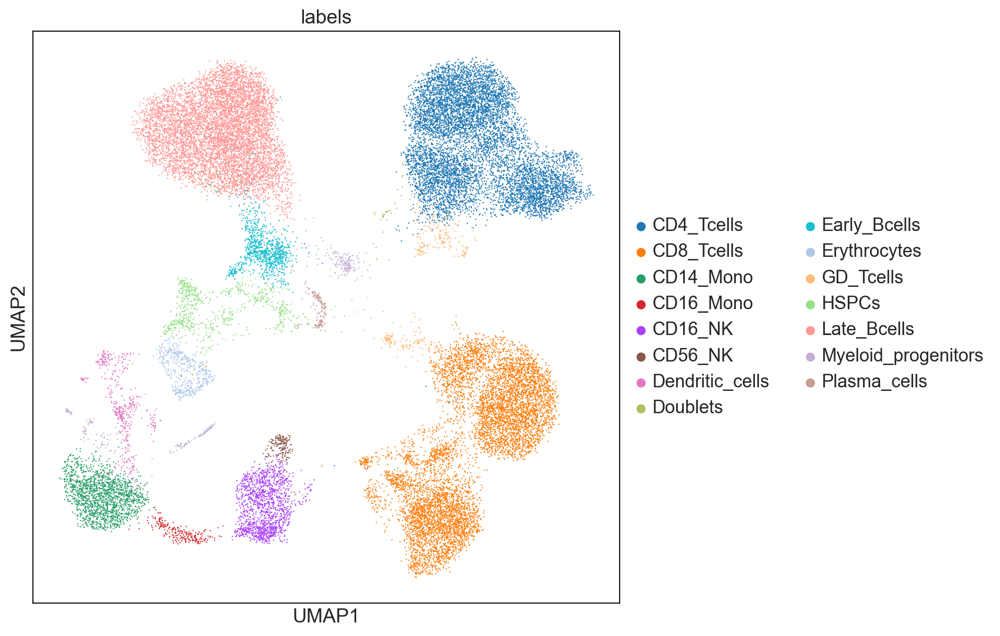

In [8]:
sc.pl.umap(adata, color='labels')

In [9]:
adata.obs["labels"].cat.categories

Index(['CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_Mono', 'CD16_NK',
       'CD56_NK', 'Dendritic_cells', 'Doublets', 'Early_Bcells',
       'Erythrocytes', 'GD_Tcells', 'HSPCs', 'Late_Bcells',
       'Myeloid_progenitors', 'Plasma_cells'],
      dtype='object')

In [10]:
sc.tl.pca(adata)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


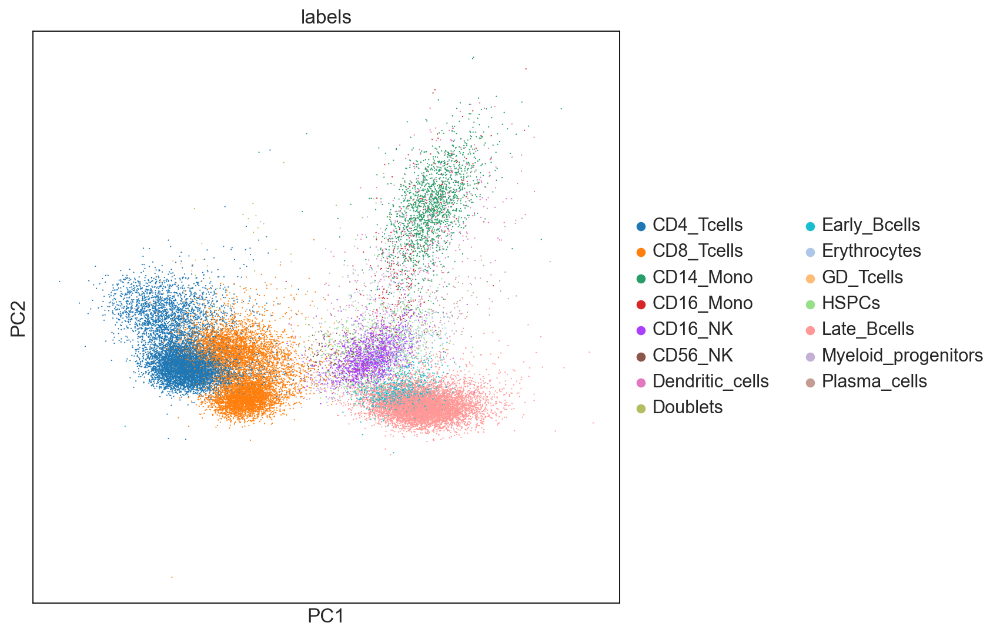

In [11]:
sc.pl.pca(adata, color='labels')

In [12]:
import scipy

In [15]:
df = adata.to_df()

In [16]:
df.columns

Index(['FSC.A', 'SSC.A', 'CD197', 'CD34', 'HLA-DR', 'CD127', 'CD123', 'CD11b',
       'CD94', 'CD16', 'CD19', 'CD33', 'TIM3', 'CD27', 'CD8', 'CD45', 'CD141',
       'CD39', 'CD71', 'CD45RO', 'CD11c', 'CD279', 'CD56', 'TCRab', 'CD45RA',
       'CD10', 'CD133', 'CD41', 'FcER1A', 'CD1c', 'CD95', 'CD25', 'CD4', 'IgD',
       'CD38', 'TCRgd', 'CD3', 'CD14', 'CD90'],
      dtype='object')

In [17]:
# df[['CD16', 'CD19']]

,CD16,CD19
1,-0.072598,-0.470135
2,-0.220523,-0.583726
3,-0.043013,1.199647
4,0.119705,-0.651880
5,-0.235315,1.654010
...,...,...
29996,-0.190938,-0.595085
29997,-0.205730,-0.436058
29998,-0.205730,0.643053
29999,-0.767845,-0.515572


In [10]:
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt

# Generate low dim simulation data
low_dim_data = np.random.normal(size=(100, 2))

# Transform low dim data to high dim
high_dim_data = np.dot(low_dim_data, np.random.normal(size=(2, 10)))

# Convert high dim data to scanpy AnnData object
high_dim_data = sc.AnnData(high_dim_data)

# Plot the KDE of each feature in high dim
sc.pl.violin(high_dim_data, color='grey')

# Place the simulation points on the KDE
sc.pl.scatter(high_dim_data, color='red', s=10)

# Plot the KDEs with subplots
sc.settings.set_figure_params(dpi=80, facecolor='white')
fig, axs = plt.subplots(5, 2, figsize=(10, 20))
for i, ax in enumerate(axs.flatten()):
    sc.pl.violin(high_dim_data, color='grey', ax=ax)
    sc.pl.scatter(high_dim_data, color='red', s=10, ax=ax)
    ax.set_title(f'Feature {i+1}')
plt.tight_layout()


/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/1092363634.py:12: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  high_dim_data = sc.AnnData(high_dim_data)


TypeError: violin() missing 1 required positional argument: 'keys'

In [18]:
adata.to_df()

,FSC.A,SSC.A,CD197,CD34,HLA-DR,CD127,CD123,CD11b,CD94,CD16,...,CD1c,CD95,CD25,CD4,IgD,CD38,TCRgd,CD3,CD14,CD90
1,0.175466,-0.265481,0.470500,-0.469157,-0.483624,0.175311,-2.090535,0.398467,-0.271225,-0.072598,...,-0.461675,1.684955,0.810609,1.639882,-0.634886,-0.065456,-0.336685,0.566197,1.315037,0.665854
2,0.661987,-0.371852,-1.811844,-0.083473,-0.724760,1.740920,0.914731,-1.454640,-0.070420,-0.220523,...,-0.376676,1.319101,0.401990,-0.673823,-0.519677,-0.618354,-0.643630,0.987942,-0.226885,0.699669
3,-1.464807,-0.744151,0.957256,-0.276315,1.035535,-0.076926,-0.221876,-1.423583,0.210706,-0.043013,...,1.355197,-0.731382,-0.306282,-0.714061,1.864258,-0.944422,-0.070667,-0.633141,-0.298188,-0.788211
4,0.828794,0.239782,0.059462,-0.616625,-0.290715,0.836346,-1.300689,-0.326212,0.866667,0.119705,...,-0.111051,0.732033,-0.197317,-0.719091,-0.590575,0.317319,0.563685,1.620560,0.869395,0.226252
5,-0.825378,-0.265481,0.924805,-0.435126,1.541921,-1.103270,-1.050250,-0.057046,-0.940573,-0.235315,...,3.395195,-0.059232,-0.374385,-0.628555,3.556941,0.955278,0.318129,-1.048297,0.896134,0.243160
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29996,-1.478707,-0.770743,1.389927,-0.049442,-0.628305,0.044843,-2.052006,-0.212334,-0.712995,-0.190938,...,-0.631675,0.417229,0.579058,1.413541,-0.838717,0.997808,-0.234370,0.842967,1.413079,0.987100
29997,0.119863,0.213189,-0.286676,1.584043,-1.592850,0.775461,-0.144818,-0.357270,-0.324773,-0.205730,...,-0.270426,1.608381,2.826461,1.720359,-0.679197,-0.575823,-0.213908,1.179045,-0.200146,-0.010456
29998,0.175466,-0.292074,0.070279,-0.185566,1.218798,-0.833637,-0.366360,-0.595378,-0.378320,-0.205730,...,2.747070,-1.888502,-0.496971,-0.804597,0.224749,-1.313020,-0.050204,-1.437093,0.013762,1.240716
29999,-1.019987,-0.026146,-0.600363,0.018619,-0.613837,-0.894522,-0.587902,1.205966,-0.793316,-0.767845,...,-0.525425,1.072363,0.020613,-0.729150,0.393131,-0.377347,-0.254833,0.058785,-0.066454,0.158622


ValueError: 'c' argument must be a color, a sequence of colors, or a sequence of numbers, not ['CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD56_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'HSPCs', 'Dendritic_cells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'GD_Tcells', 'Erythrocytes', 'HSPCs', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Erythrocytes', 'CD16_NK', 'HSPCs', 'GD_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD56_NK', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'GD_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD56_NK', 'GD_Tcells', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Doublets', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Doublets', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Myeloid_progenitors', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Doublets', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'Plasma_cells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'GD_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Erythrocytes', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'Erythrocytes', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Erythrocytes', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'CD16_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Dendritic_cells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Doublets', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD4_Tcells', 'Early_Bcells', 'Dendritic_cells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'HSPCs', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'HSPCs', 'CD8_Tcells', 'GD_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'Doublets', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Early_Bcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD16_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD16_NK', 'Erythrocytes', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Myeloid_progenitors', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Erythrocytes', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD56_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'Early_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Plasma_cells', 'HSPCs', 'CD4_Tcells', 'Early_Bcells', 'Myeloid_progenitors', 'Erythrocytes', 'Myeloid_progenitors', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'HSPCs', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'GD_Tcells', 'HSPCs', 'Late_Bcells', 'HSPCs', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Erythrocytes', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD14_Mono', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Myeloid_progenitors', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Myeloid_progenitors', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'Early_Bcells', 'Plasma_cells', 'Erythrocytes', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_Mono', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD56_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Dendritic_cells', 'Doublets', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD56_NK', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Doublets', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Early_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD56_NK', 'CD14_Mono', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Dendritic_cells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Early_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'HSPCs', 'CD16_Mono', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'GD_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Doublets', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Doublets', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'Plasma_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_Mono', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Myeloid_progenitors', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD16_Mono', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD56_NK', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Erythrocytes', 'CD16_NK', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Early_Bcells', 'GD_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD16_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Myeloid_progenitors', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'GD_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD14_Mono', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Erythrocytes', 'Erythrocytes', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Early_Bcells', 'CD56_NK', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Myeloid_progenitors', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'HSPCs', 'Early_Bcells', 'Plasma_cells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'HSPCs', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Doublets', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'Erythrocytes', 'CD16_NK', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Myeloid_progenitors', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Erythrocytes', 'Myeloid_progenitors', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'Early_Bcells', 'Dendritic_cells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Doublets', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD16_NK', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Plasma_cells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'HSPCs', 'HSPCs', 'CD16_NK', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'HSPCs', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Plasma_cells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Doublets', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'Myeloid_progenitors', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_Mono', 'CD14_Mono', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'HSPCs', 'Late_Bcells', 'HSPCs', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Doublets', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'GD_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD56_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Doublets', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Plasma_cells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD16_Mono', 'CD56_NK', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Dendritic_cells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD14_Mono', 'CD16_Mono', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Doublets', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Doublets', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD56_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD16_Mono', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'Dendritic_cells', 'GD_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Doublets', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'HSPCs', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'Erythrocytes', 'CD56_NK', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Doublets', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'HSPCs', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Early_Bcells', 'GD_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Dendritic_cells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Doublets', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Plasma_cells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Doublets', 'HSPCs', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Early_Bcells', 'CD16_NK', 'Erythrocytes', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Erythrocytes', 'Myeloid_progenitors', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'HSPCs', 'Myeloid_progenitors', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'CD14_Mono', 'Erythrocytes', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'CD4_Tcells', 'Dendritic_cells', 'CD16_NK', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'HSPCs', 'CD16_NK', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'GD_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'Erythrocytes', 'HSPCs', 'GD_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Dendritic_cells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'CD56_NK', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Doublets', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD16_Mono', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'GD_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Myeloid_progenitors', 'Dendritic_cells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_Mono', 'CD8_Tcells', 'CD16_Mono', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Early_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD16_NK', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD16_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Early_Bcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Early_Bcells', 'GD_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'CD56_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'GD_Tcells', 'HSPCs', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Doublets', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Dendritic_cells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD56_NK', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'HSPCs', 'Myeloid_progenitors', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'GD_Tcells', 'CD56_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Dendritic_cells', 'Myeloid_progenitors', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD16_NK', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'HSPCs', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'GD_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'CD16_NK', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'HSPCs', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'HSPCs', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Early_Bcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Doublets', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Dendritic_cells', 'CD16_NK', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Erythrocytes', 'Late_Bcells', 'Doublets', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Doublets', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD56_NK', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'HSPCs', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'Erythrocytes', 'CD16_Mono', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'GD_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'Myeloid_progenitors', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Doublets', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Erythrocytes', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'GD_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'Myeloid_progenitors', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Erythrocytes', 'CD8_Tcells', 'Doublets', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD16_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Plasma_cells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'GD_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Doublets', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'GD_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Myeloid_progenitors', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Doublets', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'GD_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'GD_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD56_NK', 'Erythrocytes', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'Early_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'HSPCs', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'GD_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'CD16_Mono', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'Plasma_cells', 'CD16_Mono', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Myeloid_progenitors', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Doublets', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Doublets', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Plasma_cells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Dendritic_cells', 'HSPCs', 'CD4_Tcells', 'Dendritic_cells', 'Doublets', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Plasma_cells', 'Erythrocytes', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'Myeloid_progenitors', 'Erythrocytes', 'HSPCs', 'CD4_Tcells', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Myeloid_progenitors', 'Doublets', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD16_NK', 'CD16_NK', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Erythrocytes', 'Late_Bcells', 'Early_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'Erythrocytes', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Myeloid_progenitors', 'CD4_Tcells', 'CD16_NK', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'HSPCs', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_Mono', 'Early_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD14_Mono', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD56_NK', 'CD16_NK', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Erythrocytes', 'CD14_Mono', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Plasma_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD16_NK', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD56_NK', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Dendritic_cells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Plasma_cells', 'HSPCs', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD4_Tcells', 'Erythrocytes', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Doublets', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'GD_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'CD16_Mono', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD16_NK', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD56_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Erythrocytes', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'GD_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'CD14_Mono', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'Doublets', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Doublets', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Plasma_cells', 'Late_Bcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD14_Mono', 'HSPCs', 'Doublets', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Erythrocytes', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Doublets', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'HSPCs', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD16_NK', 'Dendritic_cells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Doublets', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'Dendritic_cells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_Mono', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'Plasma_cells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'HSPCs', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Doublets', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'Dendritic_cells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'HSPCs', 'Late_Bcells', 'Myeloid_progenitors', 'Dendritic_cells', 'Erythrocytes', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Dendritic_cells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'Erythrocytes', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Doublets', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Plasma_cells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'HSPCs', 'CD16_NK', 'Plasma_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'Plasma_cells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'GD_Tcells', 'CD14_Mono', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Early_Bcells', 'Dendritic_cells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'GD_Tcells', 'HSPCs', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD14_Mono', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Erythrocytes', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD56_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD16_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD8_Tcells', 'Myeloid_progenitors', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Early_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'Doublets', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'Myeloid_progenitors', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Doublets', 'Late_Bcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'HSPCs', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD14_Mono', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Dendritic_cells', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'HSPCs', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'HSPCs', 'Erythrocytes', 'GD_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD56_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Plasma_cells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'Plasma_cells', 'Late_Bcells', 'Plasma_cells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'GD_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD16_Mono', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD16_Mono', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Plasma_cells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'Erythrocytes', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'HSPCs', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'GD_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD16_NK', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Dendritic_cells', 'Erythrocytes', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'GD_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'HSPCs', 'CD4_Tcells', 'Erythrocytes', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'CD16_NK', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'Erythrocytes', 'Late_Bcells', 'CD56_NK', 'Early_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'HSPCs', 'Myeloid_progenitors', 'Early_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Doublets', 'CD4_Tcells', 'CD16_Mono', 'Erythrocytes', 'CD14_Mono', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'GD_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'HSPCs', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'Late_Bcells', 'CD16_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Plasma_cells', 'CD16_NK', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Erythrocytes', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'CD14_Mono', 'Late_Bcells', 'Dendritic_cells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_Mono', 'CD4_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD56_NK', 'CD8_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD16_NK', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD4_Tcells', 'GD_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'Erythrocytes', 'HSPCs', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Plasma_cells', 'Early_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Erythrocytes', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD16_NK', 'Erythrocytes', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'CD16_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Plasma_cells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD14_Mono', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'HSPCs', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'Dendritic_cells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD56_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Dendritic_cells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD8_Tcells', 'CD4_Tcells', 'GD_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Early_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD14_Mono', 'CD8_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD14_Mono', 'CD4_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Myeloid_progenitors', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'Early_Bcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD14_Mono', 'CD4_Tcells', 'Early_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD14_Mono', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Early_Bcells', 'CD14_Mono', 'CD8_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD56_NK', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Dendritic_cells', 'Early_Bcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD14_Mono', 'Late_Bcells', 'Late_Bcells', 'CD56_NK', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_NK', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Dendritic_cells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD16_Mono', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Myeloid_progenitors', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD14_Mono', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'Late_Bcells', 'Erythrocytes', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'Myeloid_progenitors', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'Early_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Doublets', 'CD8_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Early_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'HSPCs', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'HSPCs', 'CD4_Tcells', 'Myeloid_progenitors', 'HSPCs', 'CD8_Tcells', 'CD16_NK', 'CD4_Tcells', 'CD14_Mono', 'HSPCs', 'CD4_Tcells', 'CD16_NK', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD14_Mono', 'CD8_Tcells', 'CD16_NK', 'CD16_NK', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'CD8_Tcells', 'CD16_NK', 'CD14_Mono', 'CD16_Mono', 'Late_Bcells', 'CD8_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD4_Tcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD8_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'CD8_Tcells', 'CD4_Tcells', 'Late_Bcells', 'CD16_NK', 'CD4_Tcells', 'CD4_Tcells', 'CD4_Tcells', 'Late_Bcells', 'Erythrocytes', 'CD4_Tcells']

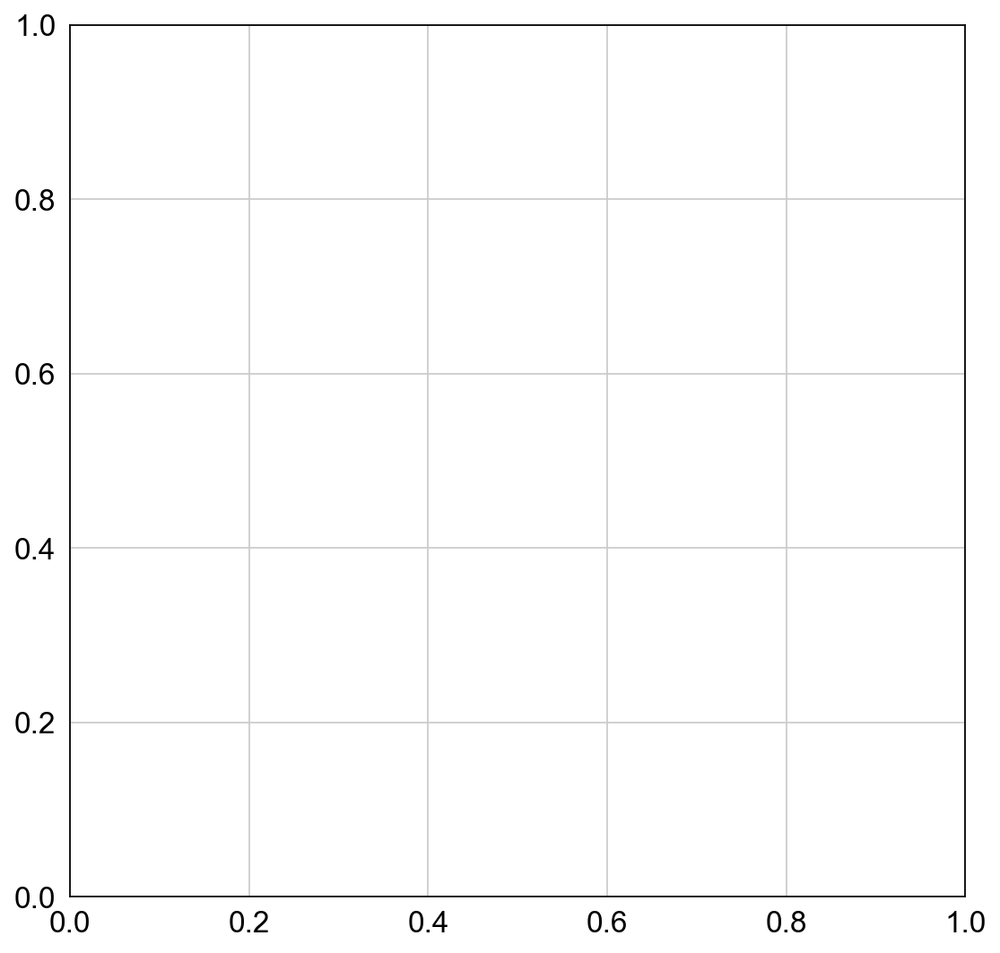

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Load the data into a pandas DataFrame
df = adata.to_df()

# Create an instance of PCA
pca = PCA(n_components=2)

# Fit PCA on the data
pca.fit(df)

# Transform the data into PCA space
pca_result = pca.transform(df)

# Plot the PCA results
plt.scatter(pca_result[:, 0], pca_result[:, 1], c = labels)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()


In [24]:
labels

['CD4_Tcells',
 'CD8_Tcells',
 'Late_Bcells',
 'CD8_Tcells',
 'Late_Bcells',
 'CD8_Tcells',
 'Late_Bcells',
 'CD4_Tcells',
 'Late_Bcells',
 'CD8_Tcells',
 'CD8_Tcells',
 'Late_Bcells',
 'CD4_Tcells',
 'CD8_Tcells',
 'CD8_Tcells',
 'CD4_Tcells',
 'CD4_Tcells',
 'CD16_Mono',
 'CD4_Tcells',
 'CD4_Tcells',
 'CD8_Tcells',
 'Late_Bcells',
 'Late_Bcells',
 'Late_Bcells',
 'CD16_NK',
 'CD8_Tcells',
 'Late_Bcells',
 'CD4_Tcells',
 'CD16_NK',
 'Late_Bcells',
 'CD8_Tcells',
 'Early_Bcells',
 'Late_Bcells',
 'Early_Bcells',
 'Late_Bcells',
 'Late_Bcells',
 'CD8_Tcells',
 'Late_Bcells',
 'HSPCs',
 'CD8_Tcells',
 'CD8_Tcells',
 'CD8_Tcells',
 'CD4_Tcells',
 'CD4_Tcells',
 'CD4_Tcells',
 'Late_Bcells',
 'CD4_Tcells',
 'Dendritic_cells',
 'CD8_Tcells',
 'Late_Bcells',
 'CD14_Mono',
 'CD8_Tcells',
 'CD4_Tcells',
 'CD8_Tcells',
 'CD4_Tcells',
 'CD8_Tcells',
 'GD_Tcells',
 'CD4_Tcells',
 'HSPCs',
 'CD8_Tcells',
 'CD8_Tcells',
 'CD4_Tcells',
 'CD8_Tcells',
 'CD4_Tcells',
 'Late_Bcells',
 'HSPCs',
 'Early_

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


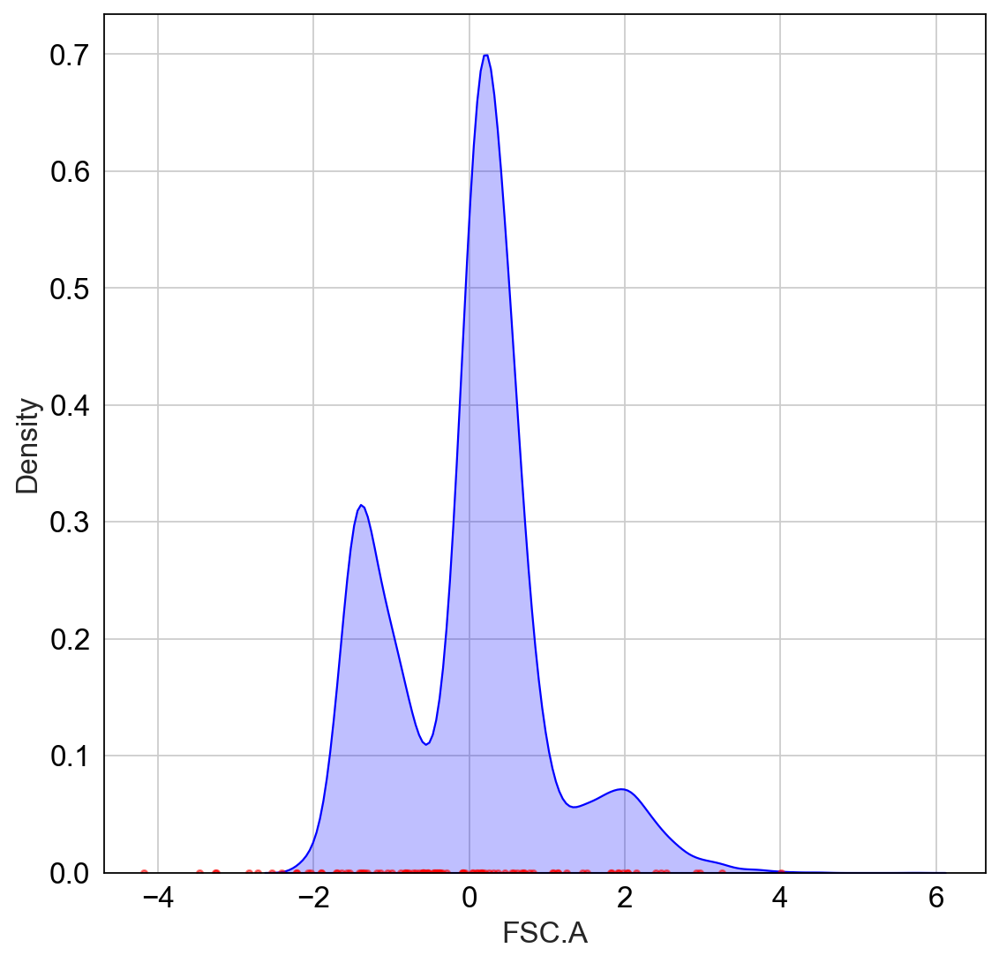

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


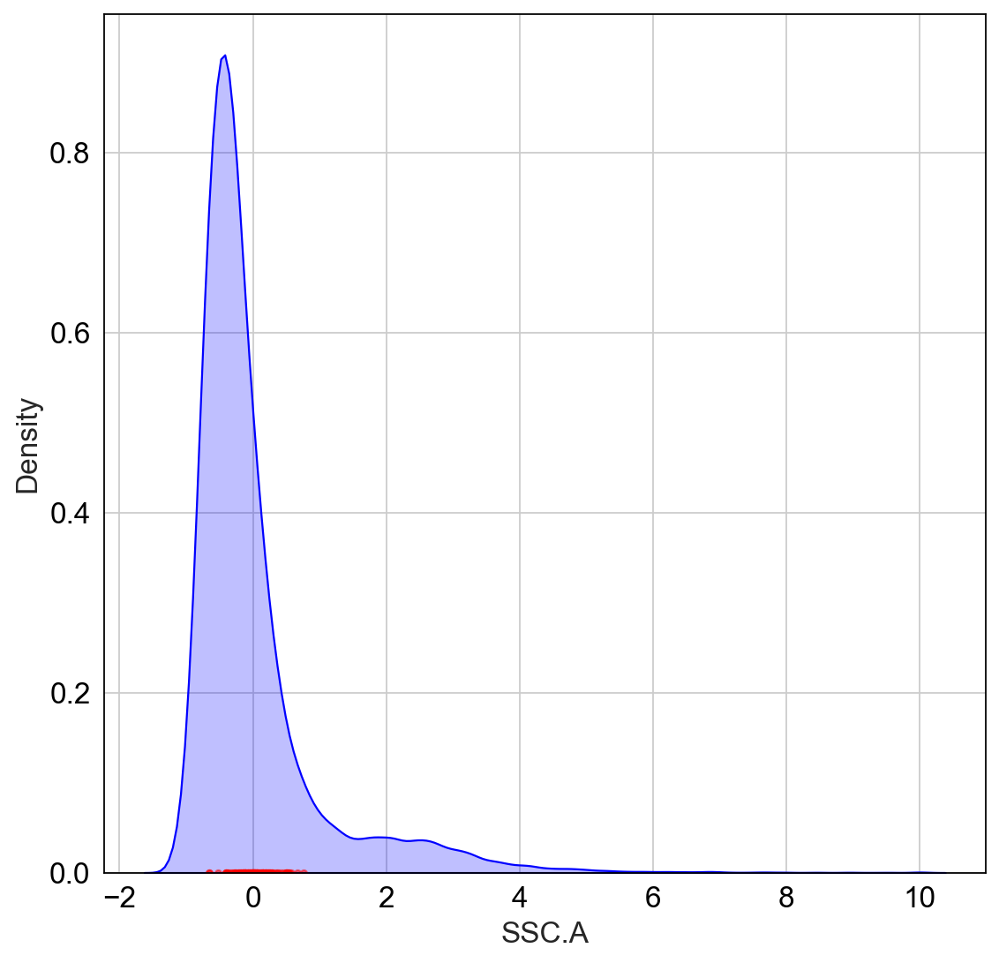

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


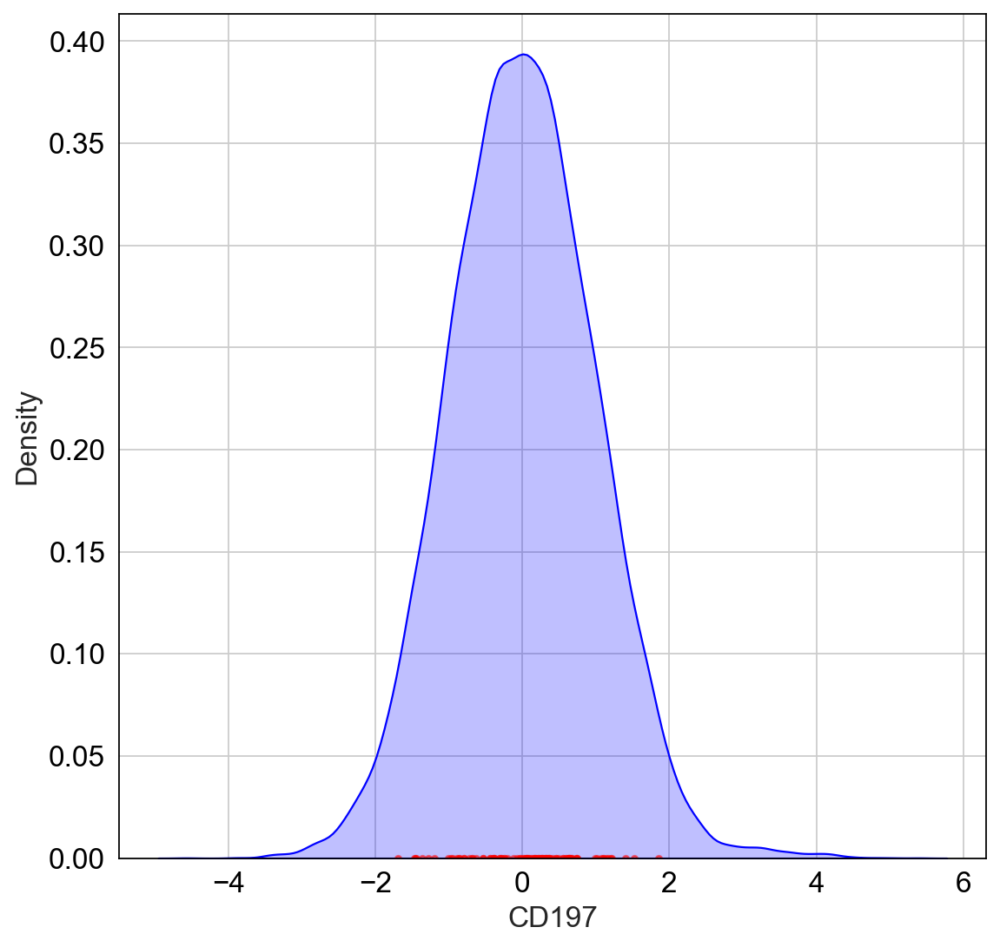

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


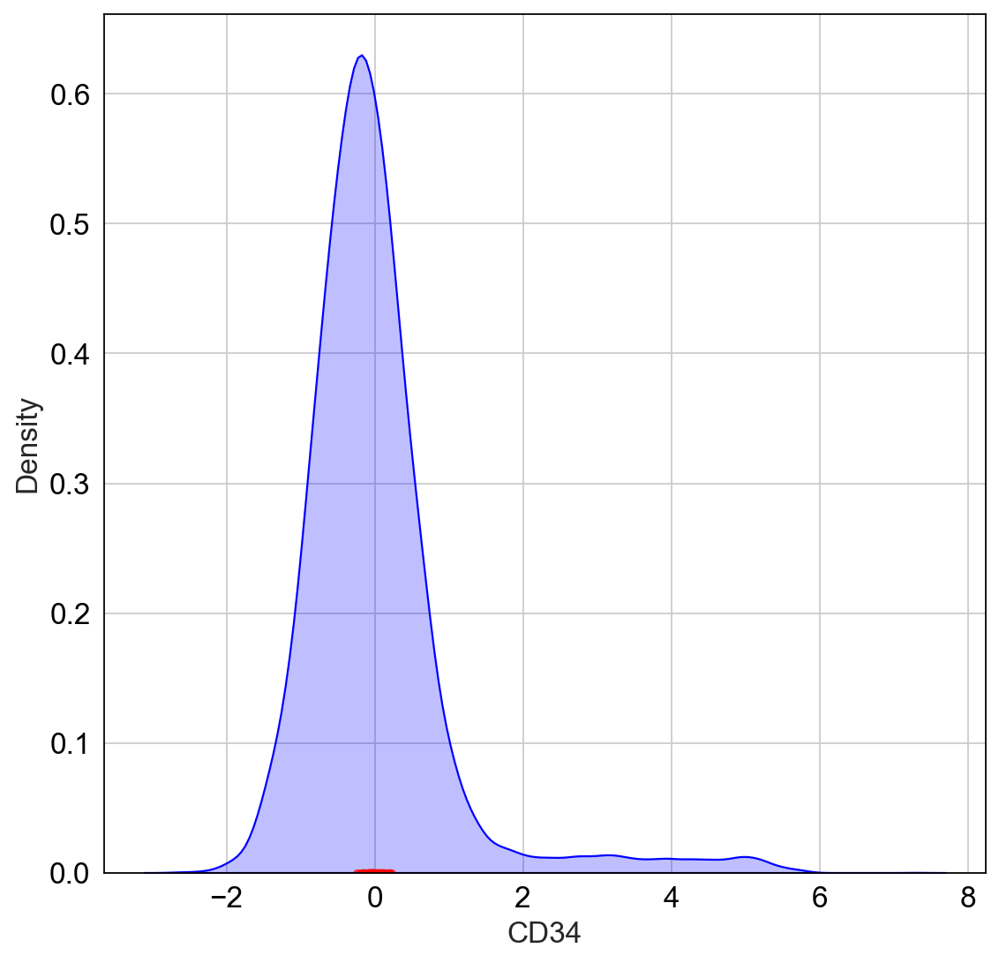

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


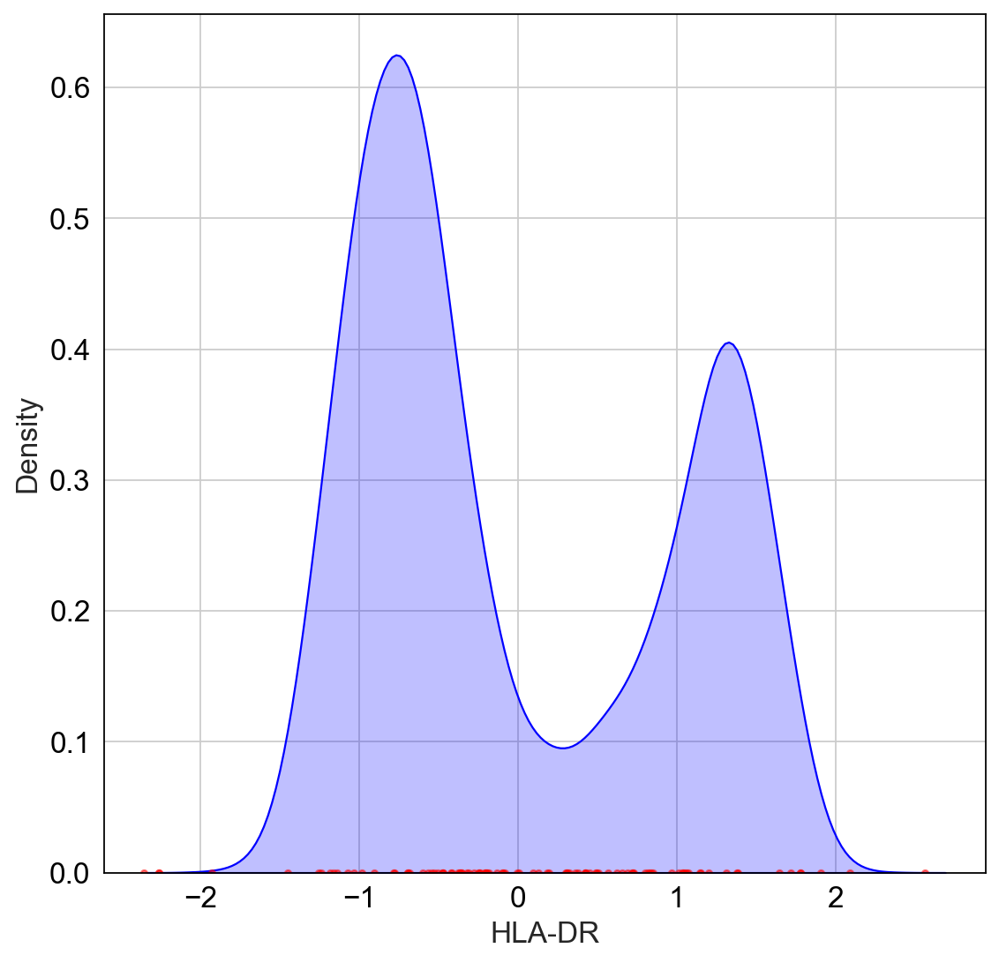

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


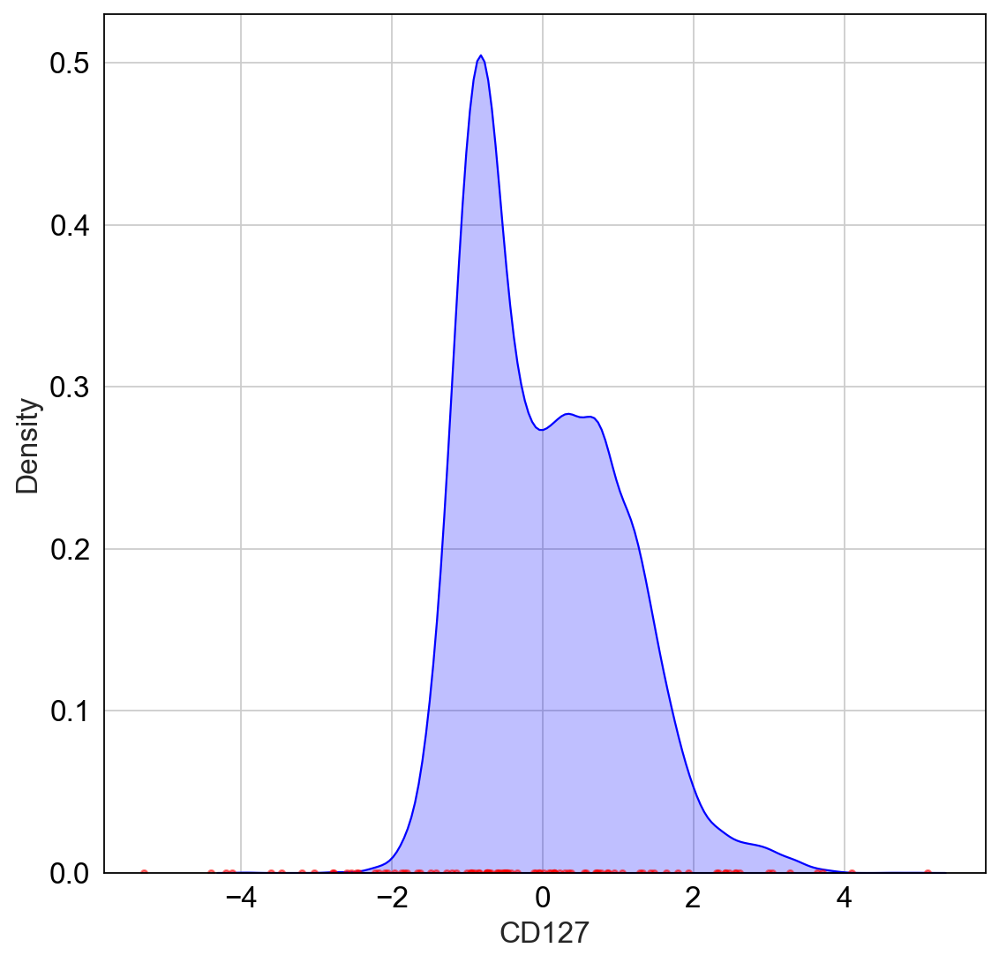

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


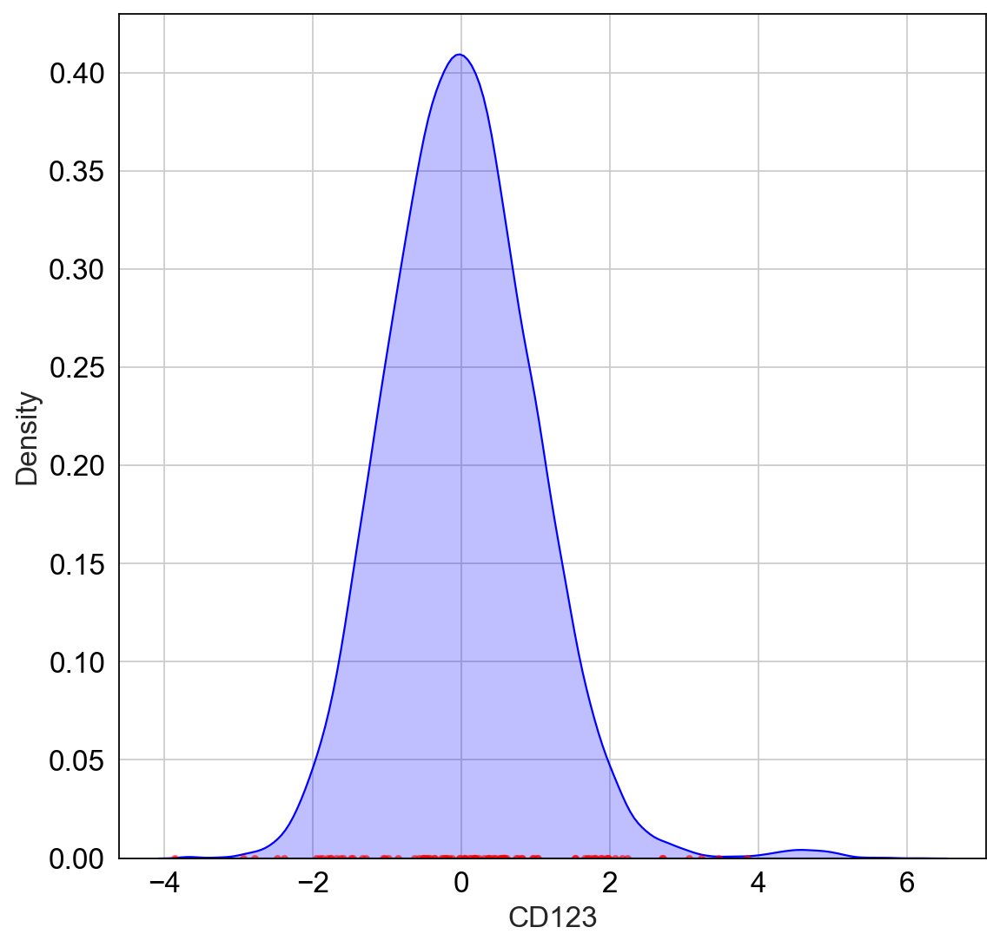

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


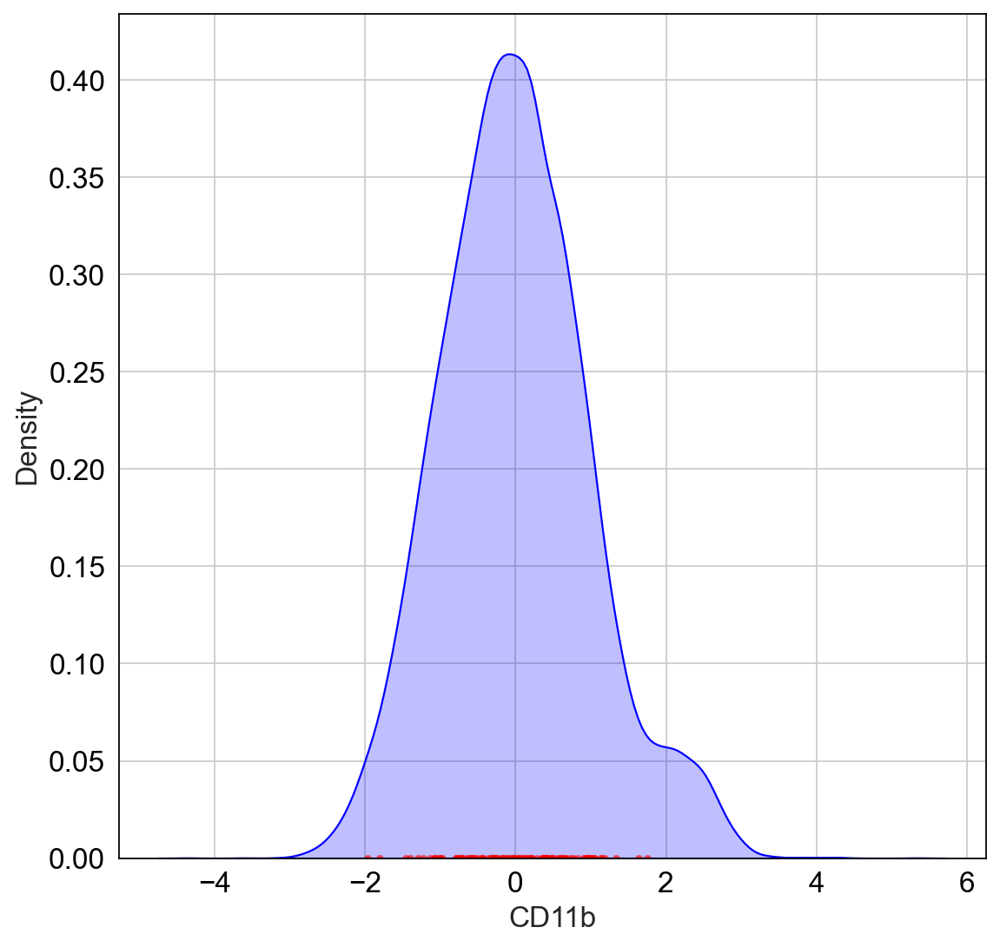

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


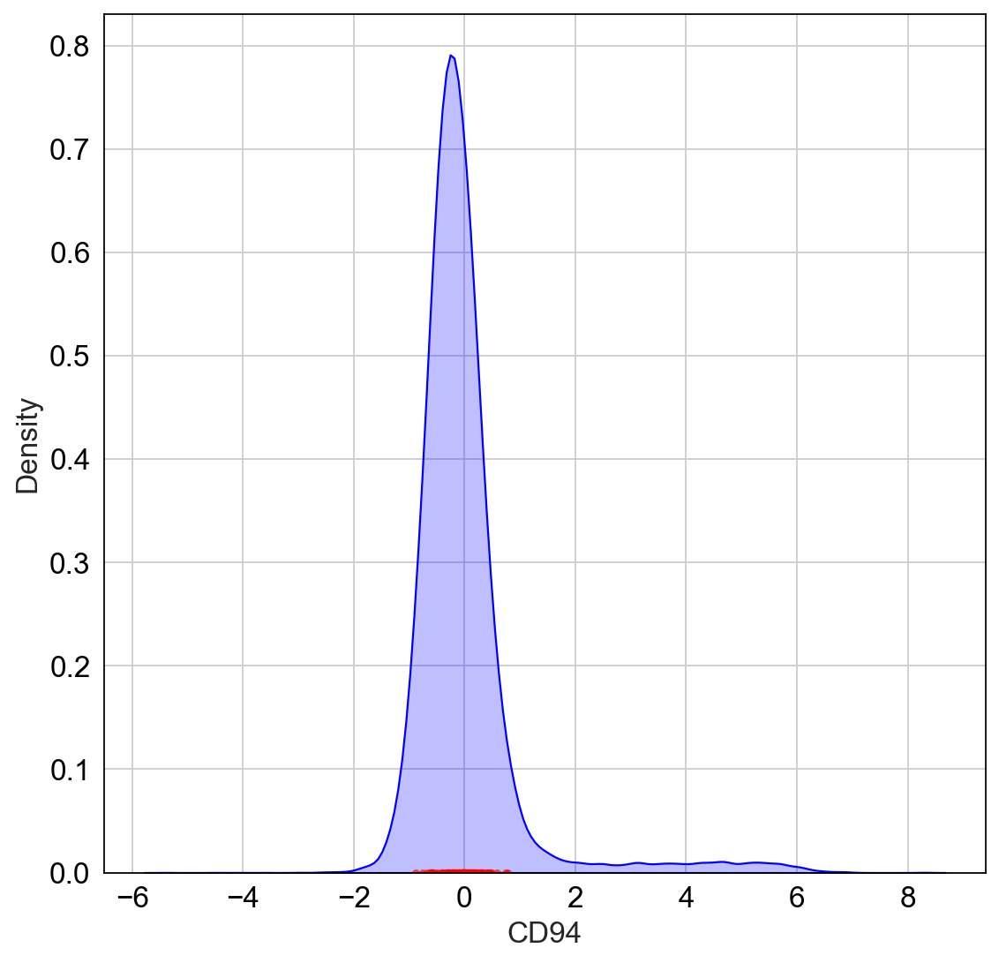

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


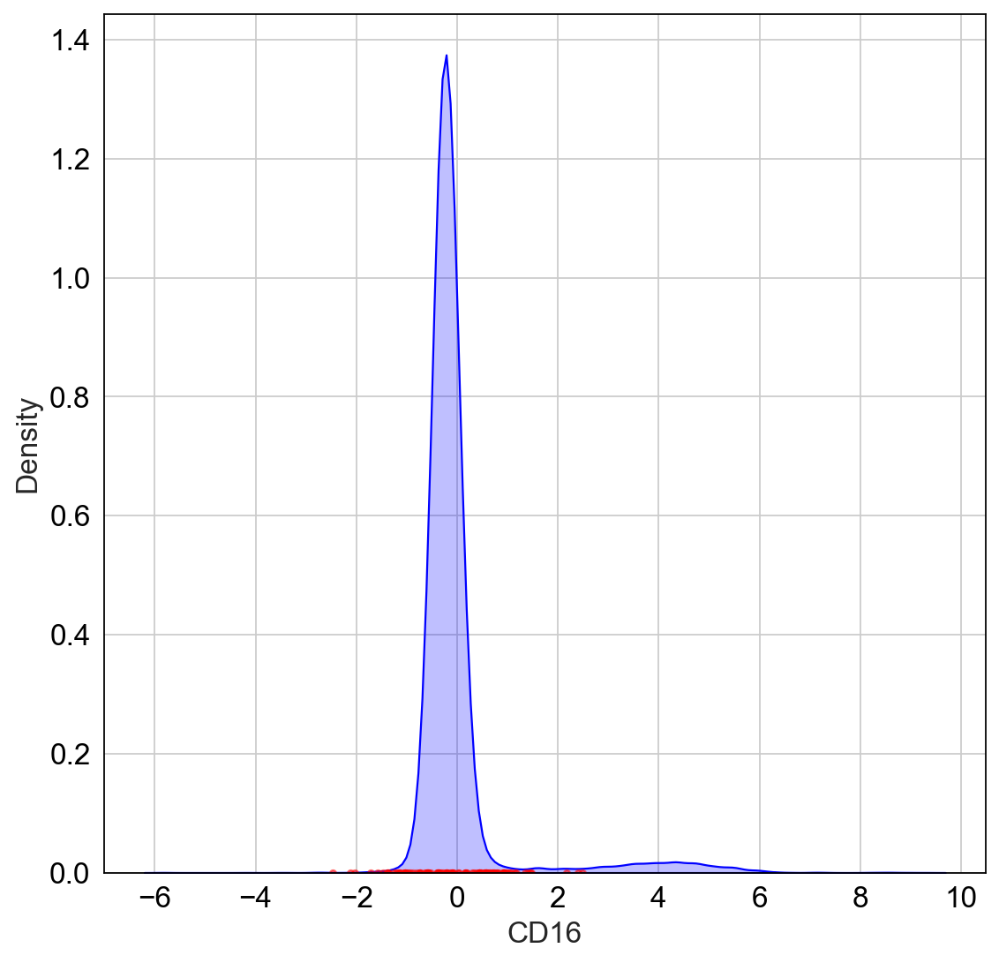

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


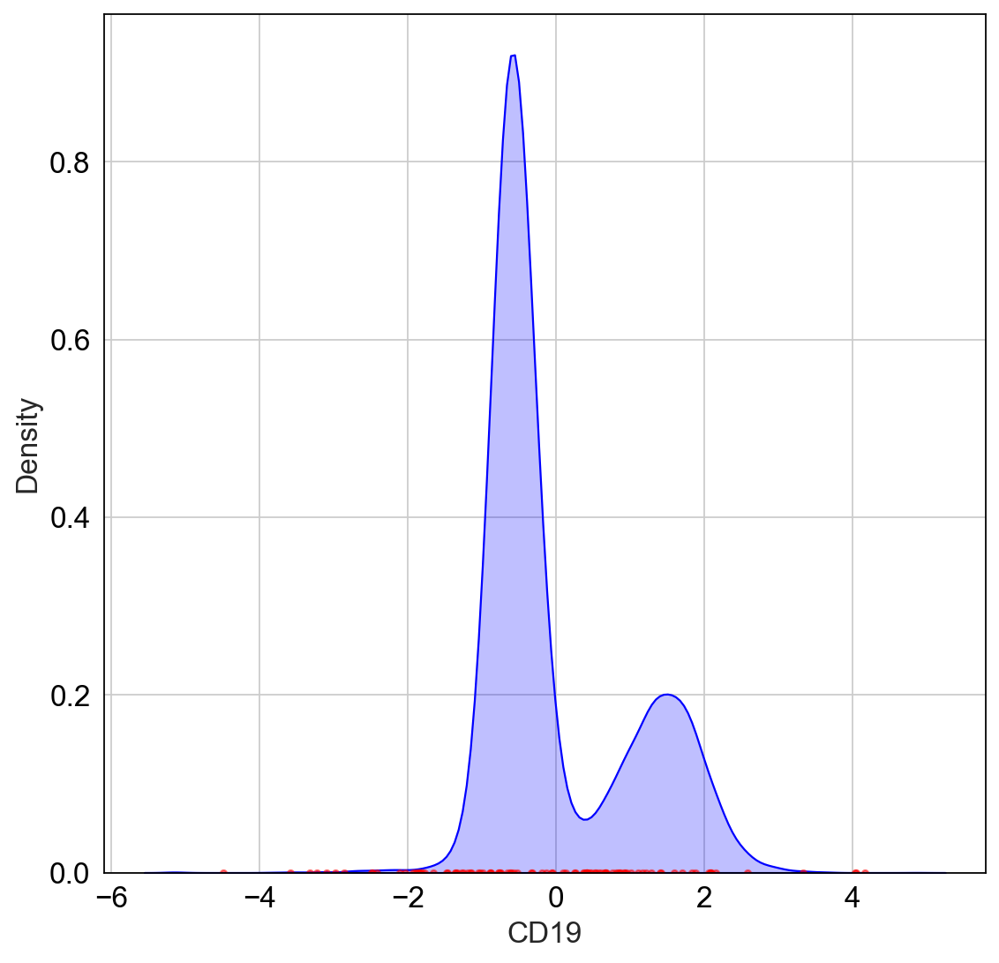

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


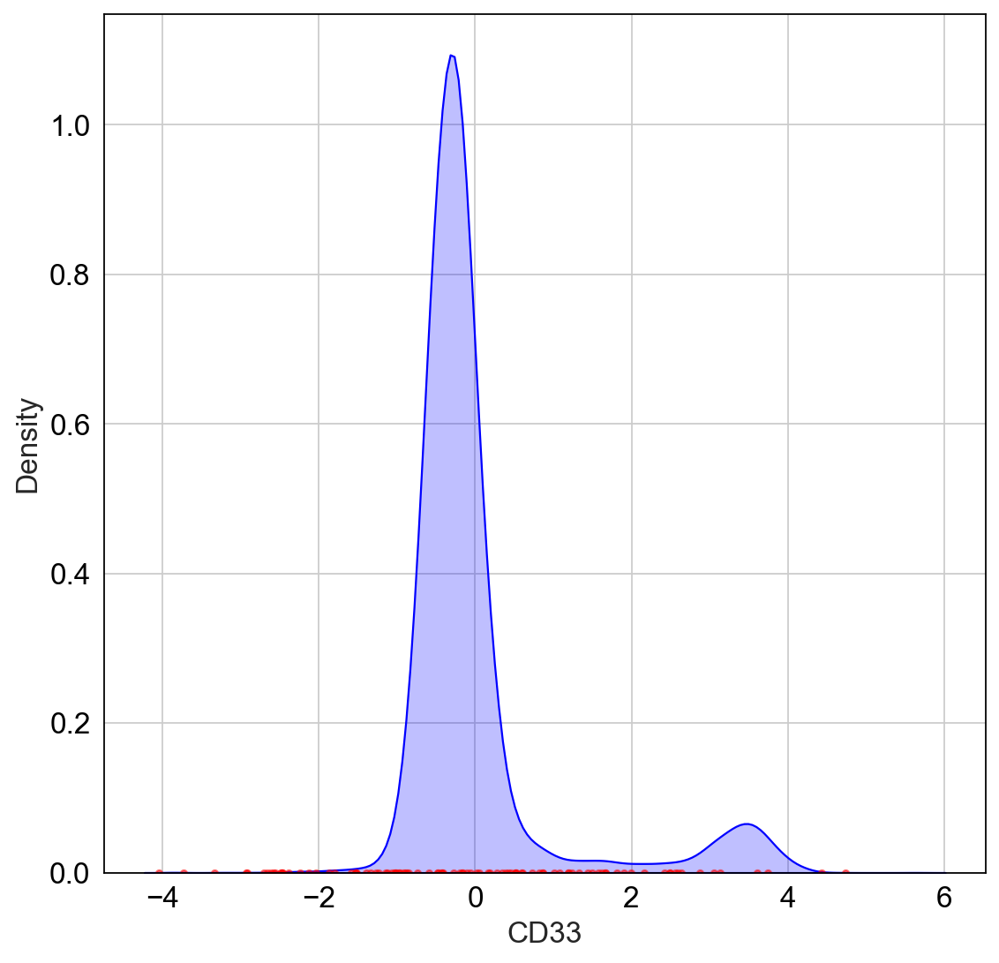

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


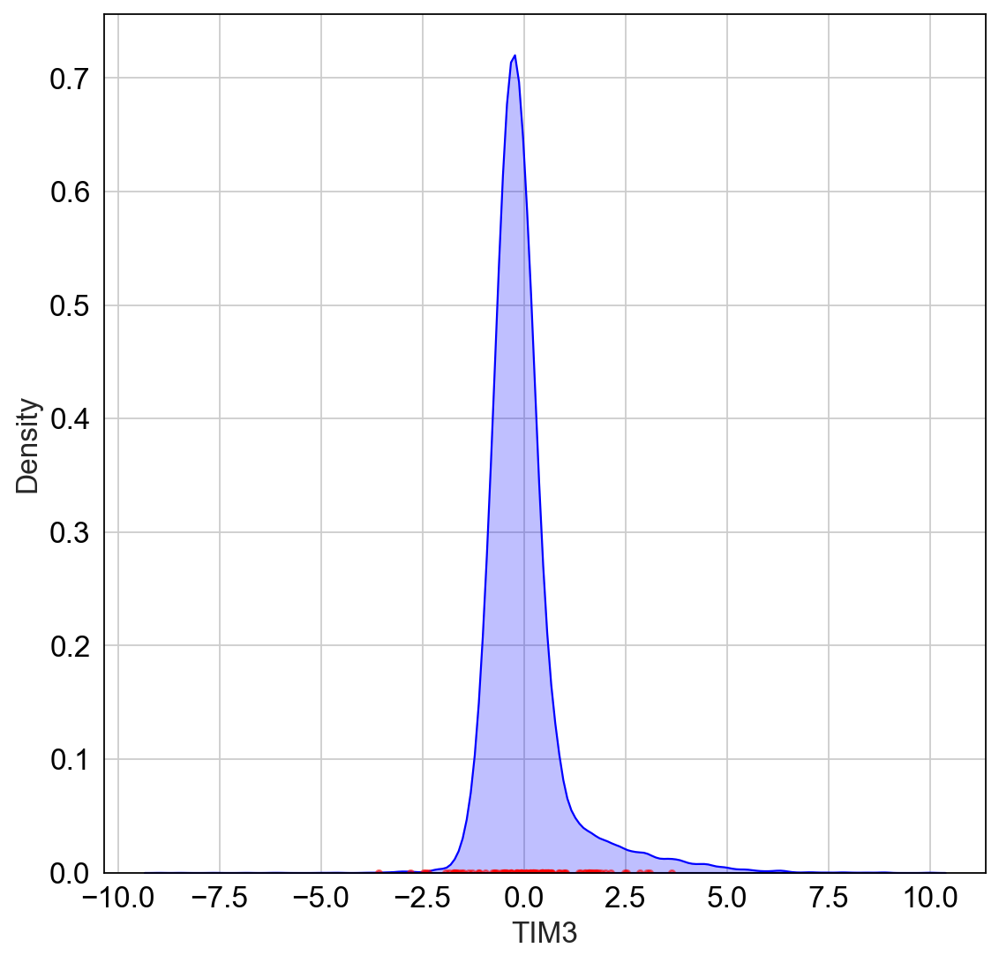

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


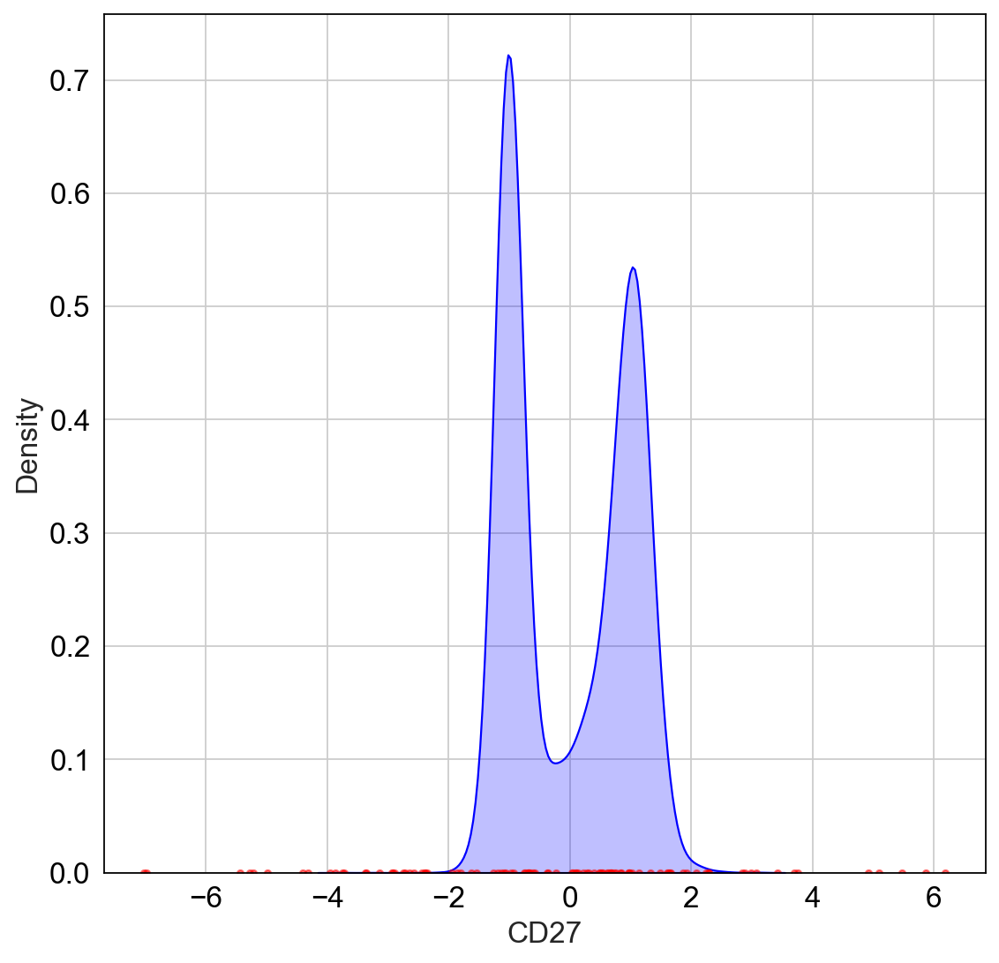

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


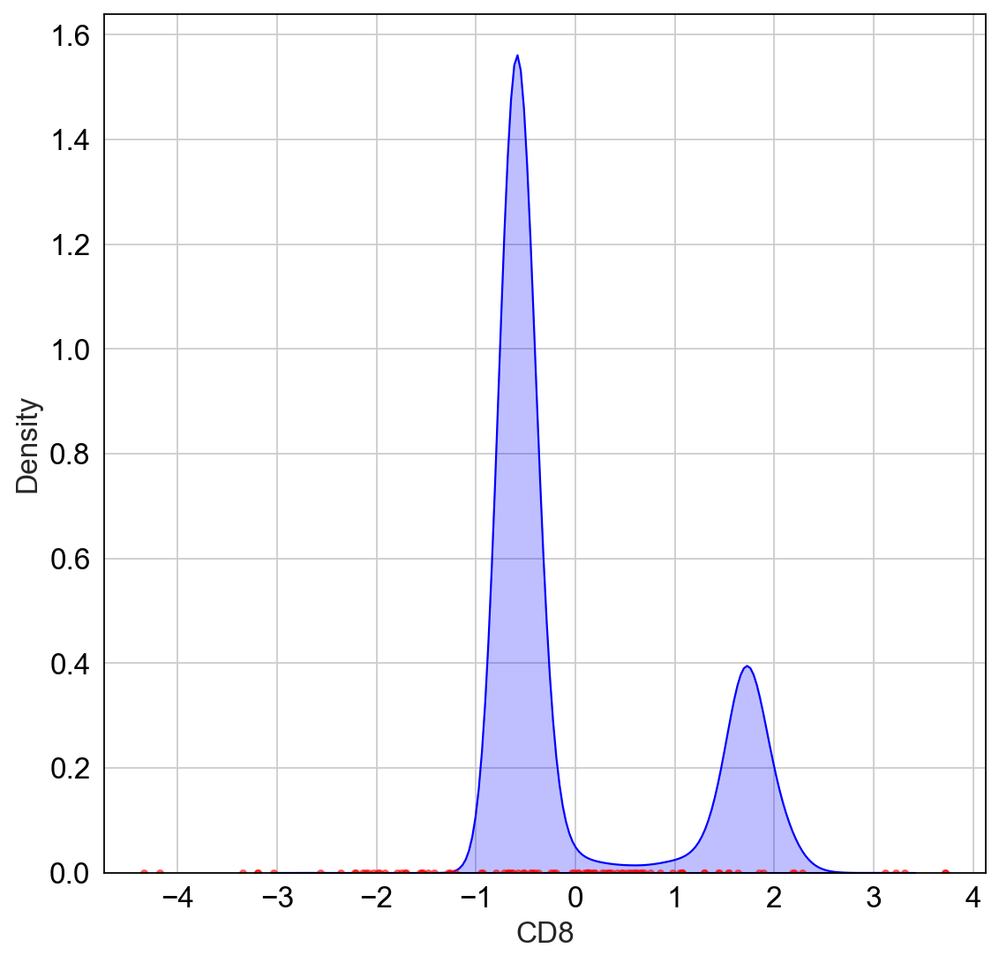

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


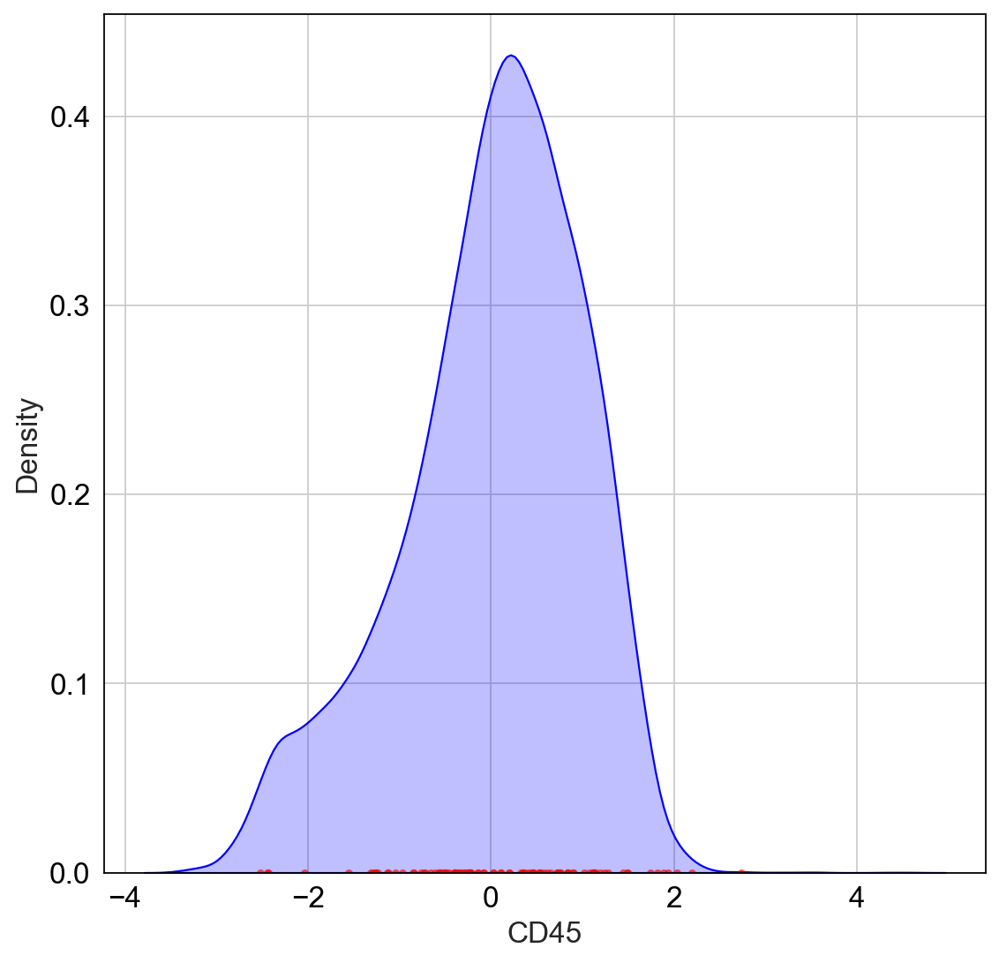

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


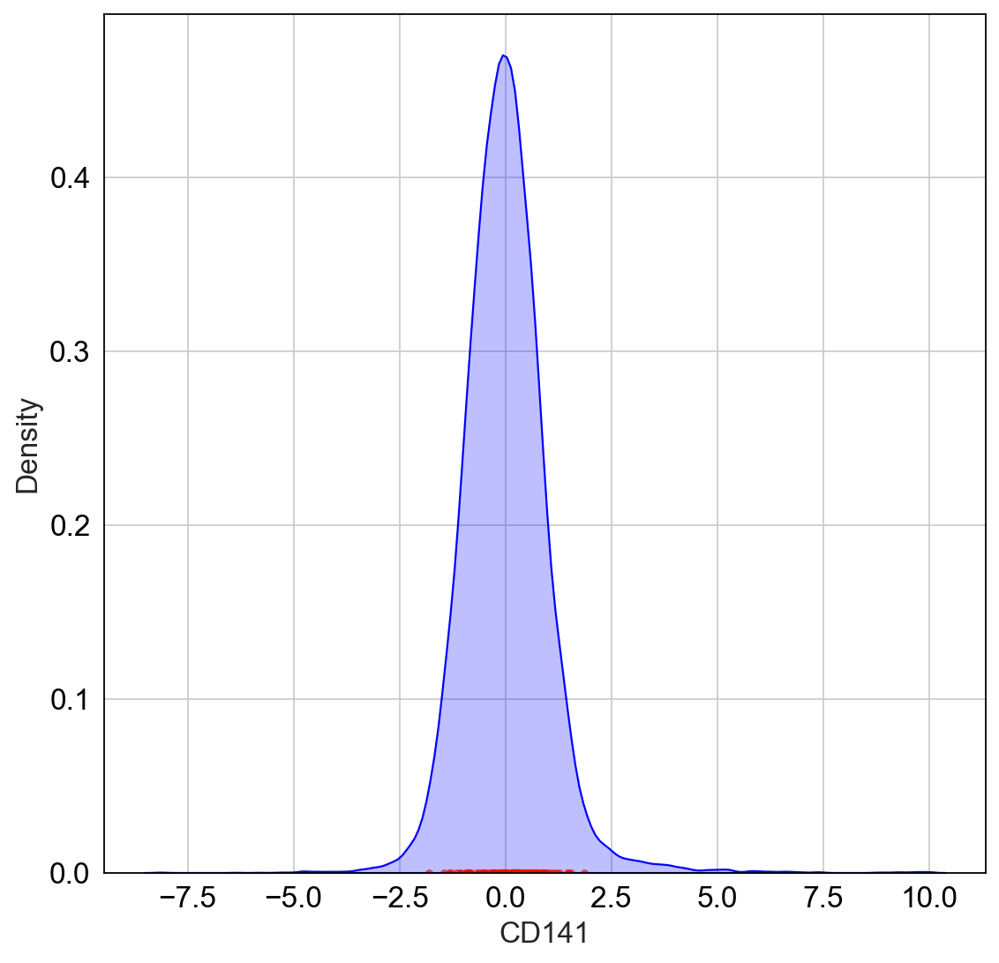

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


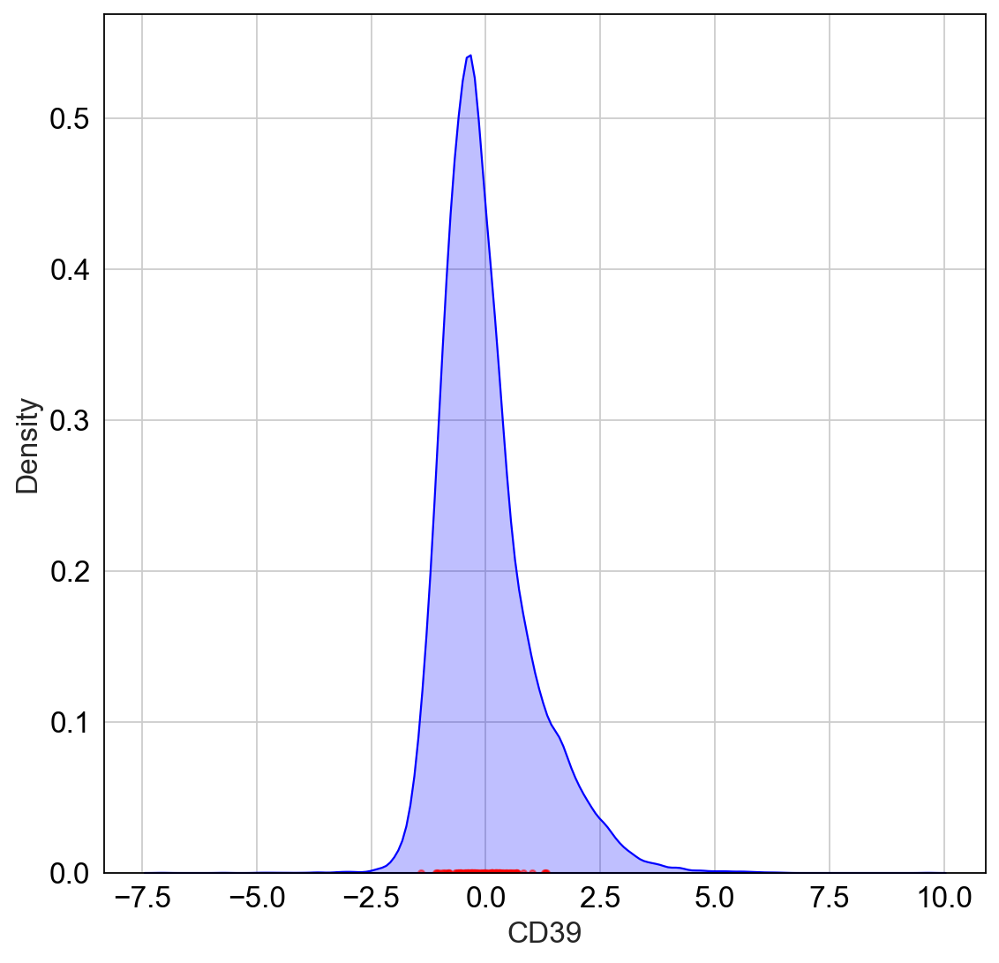

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


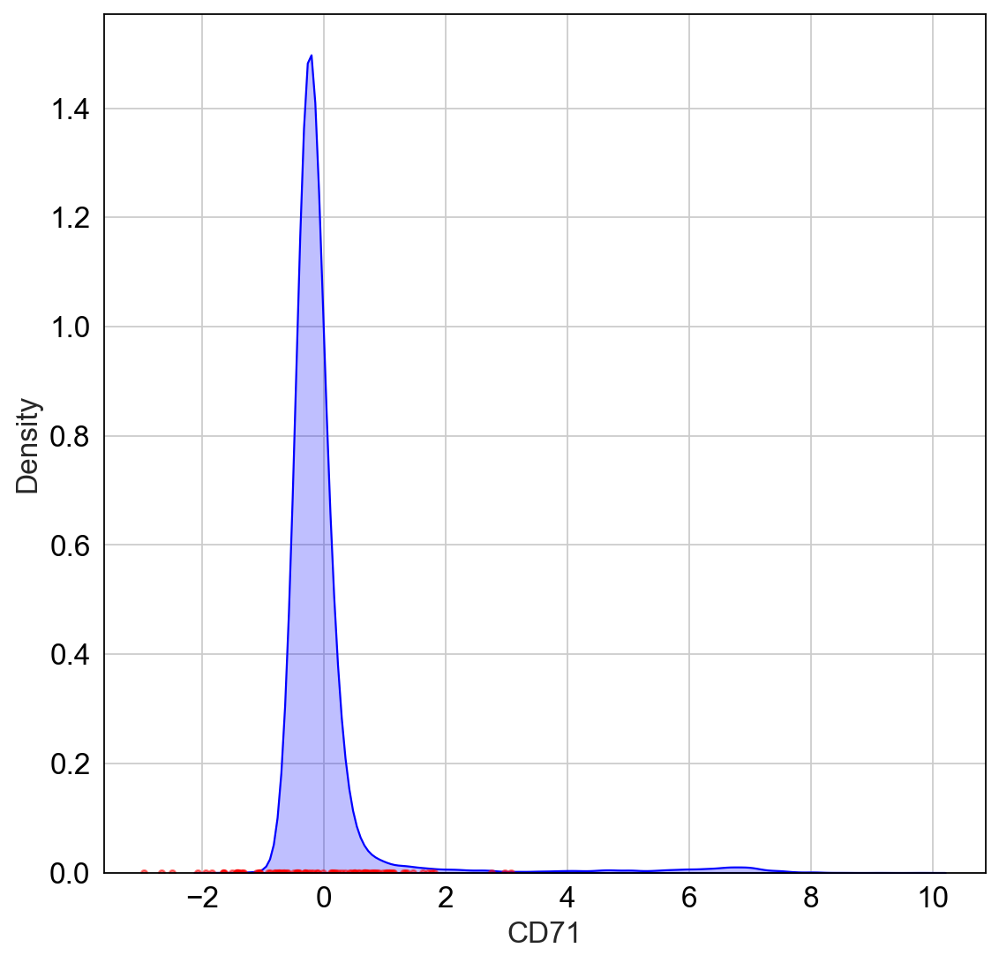

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


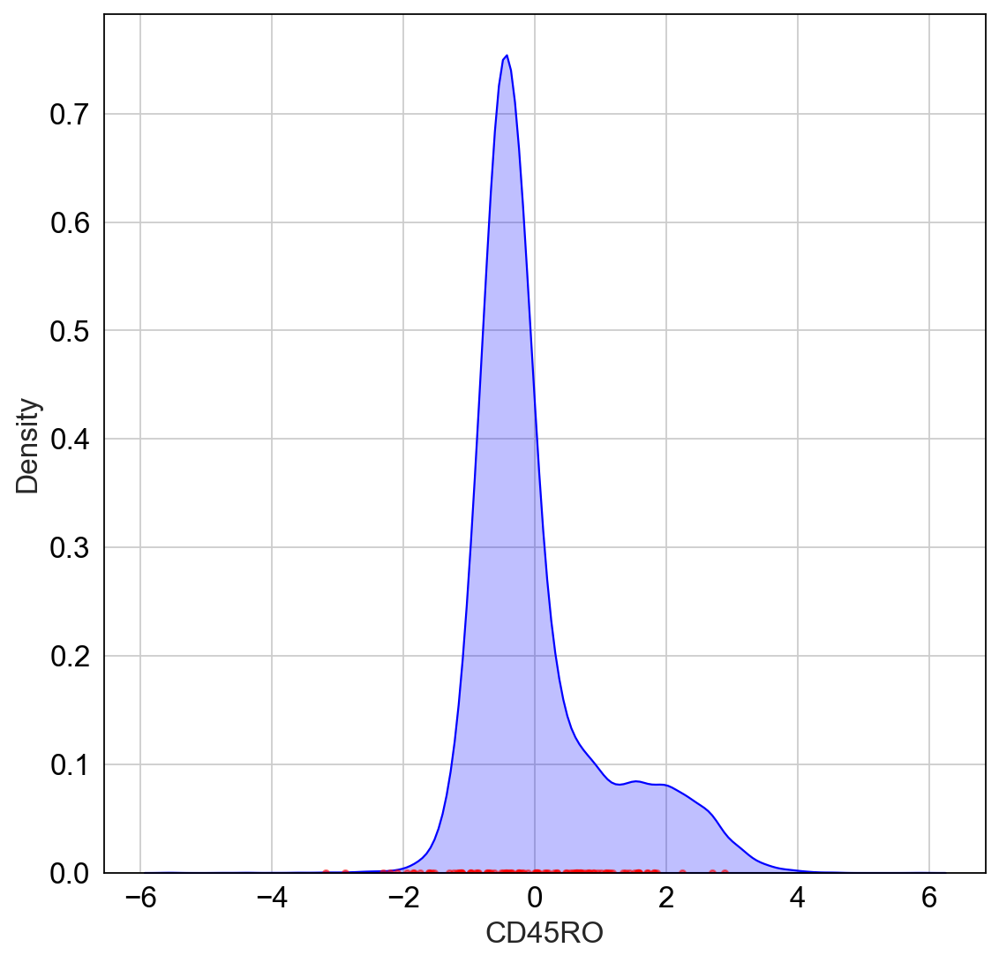

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


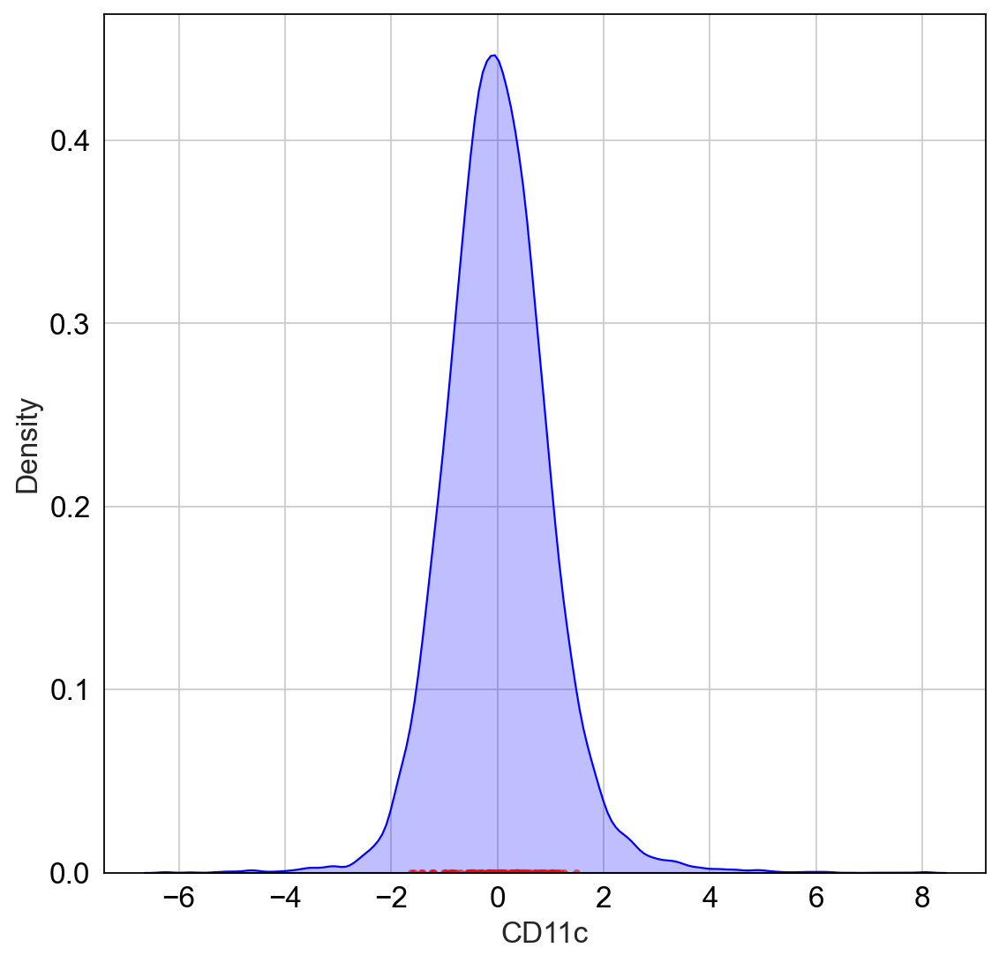

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


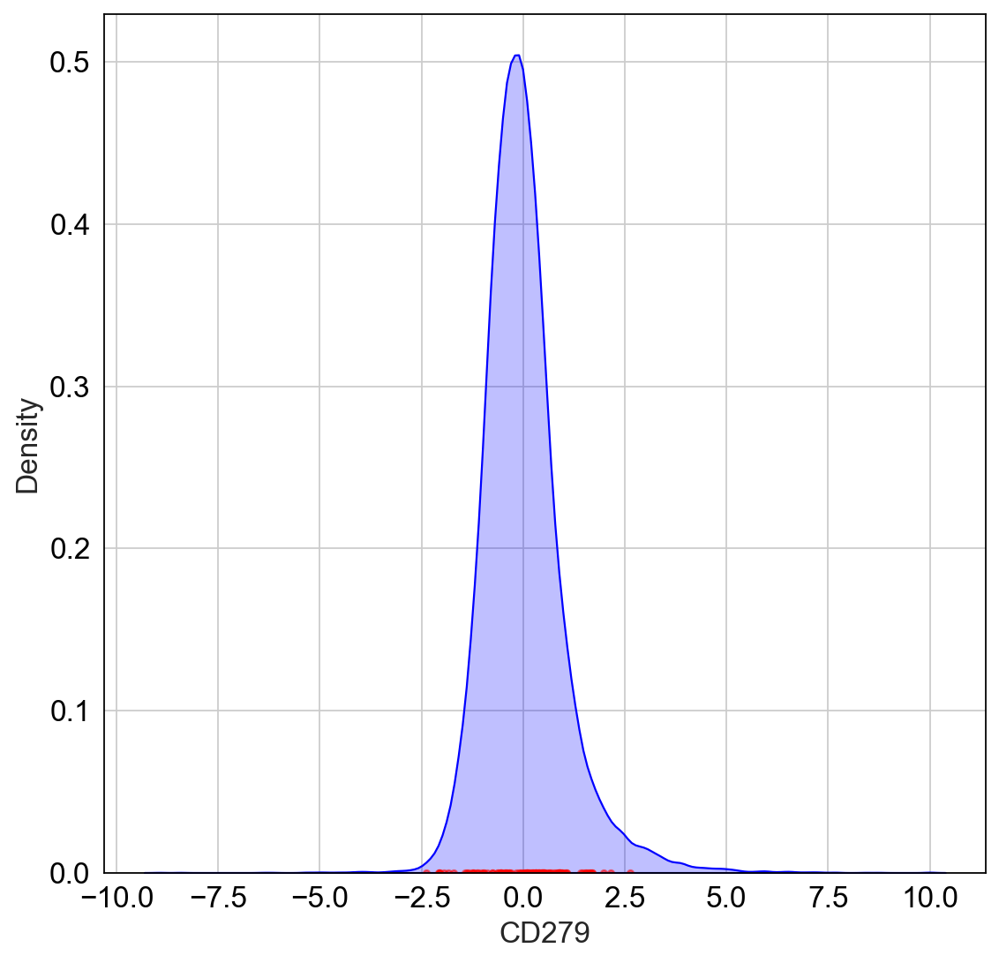

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


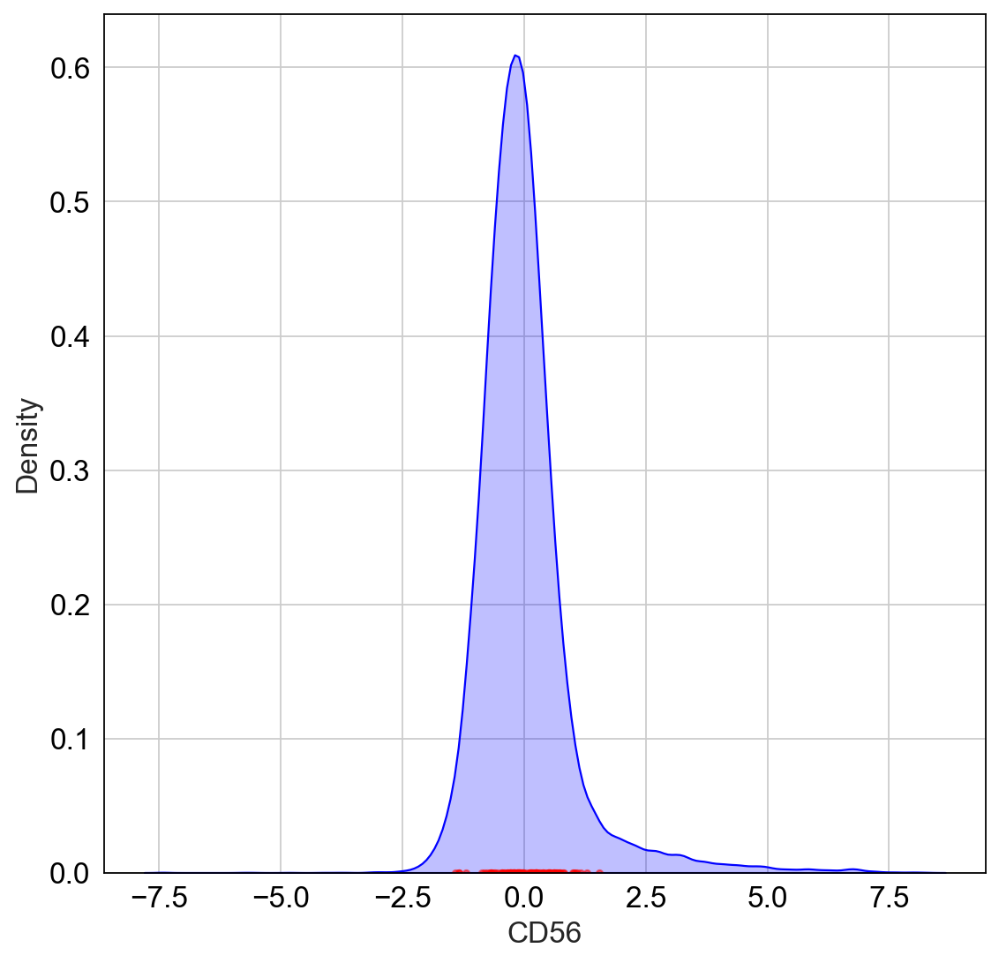

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


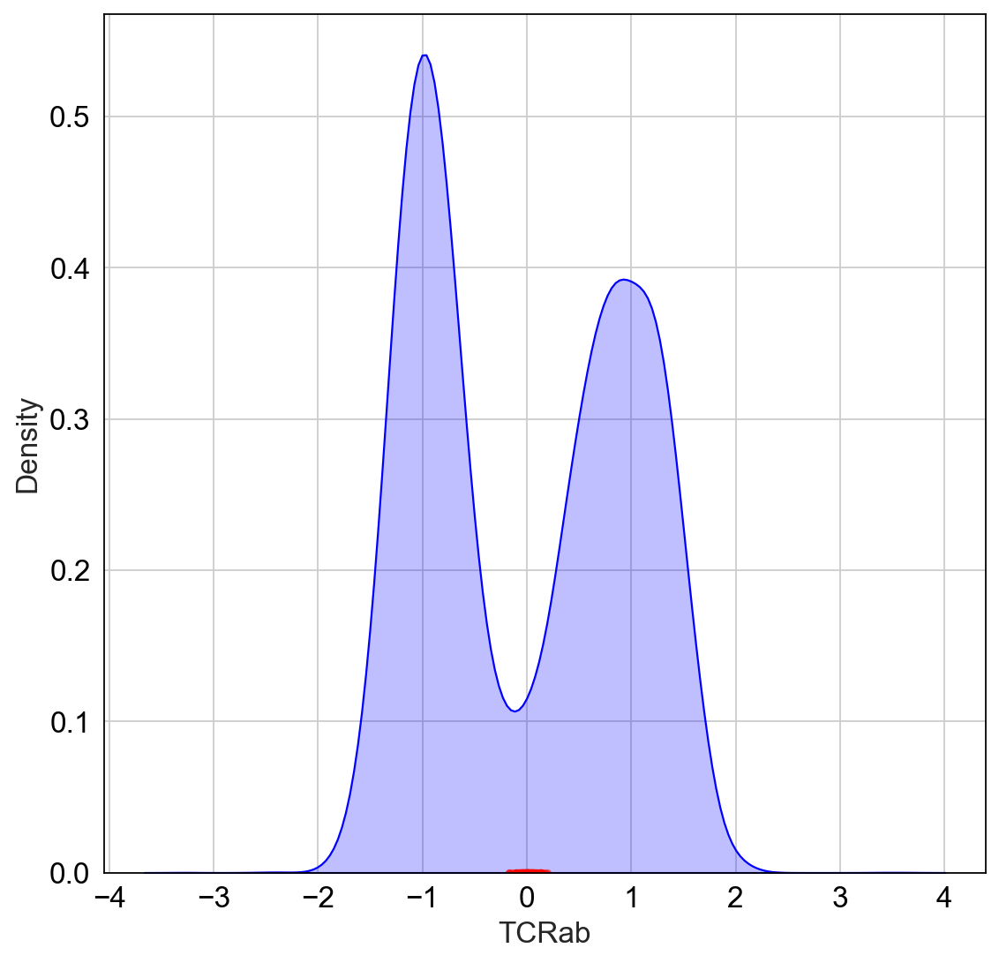

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


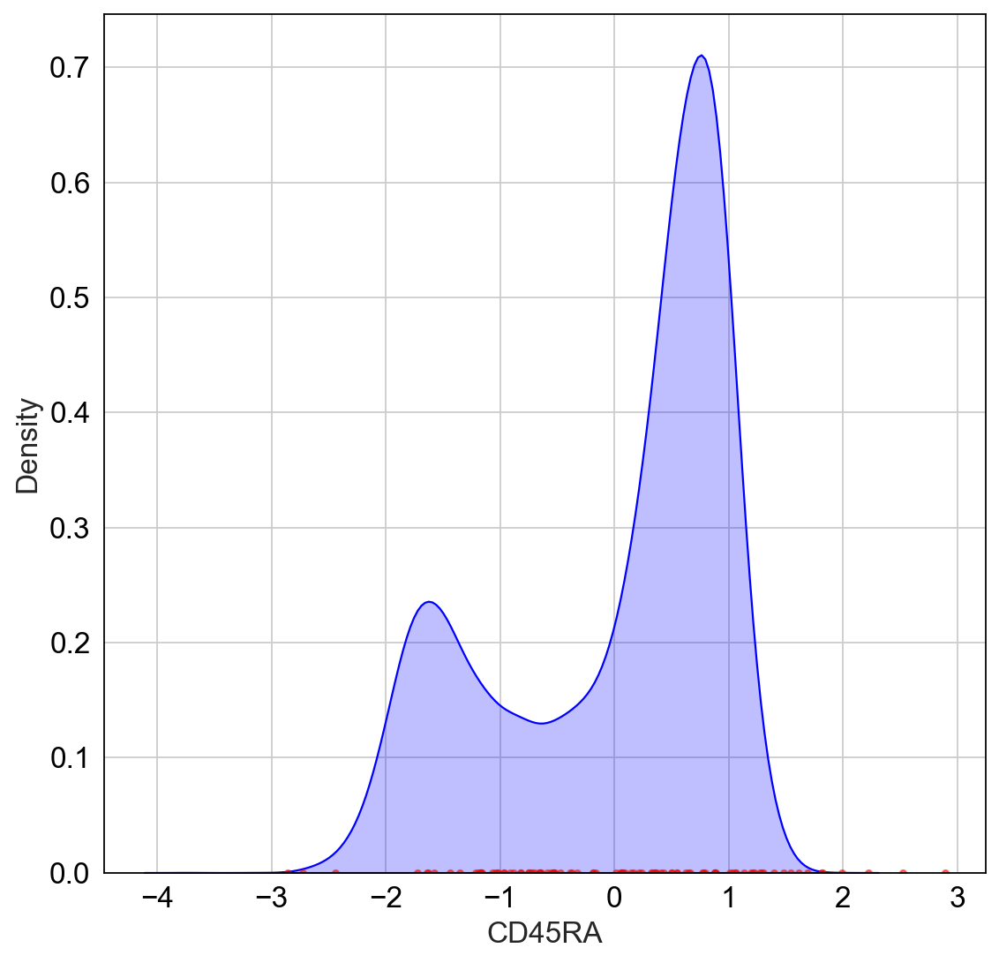

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


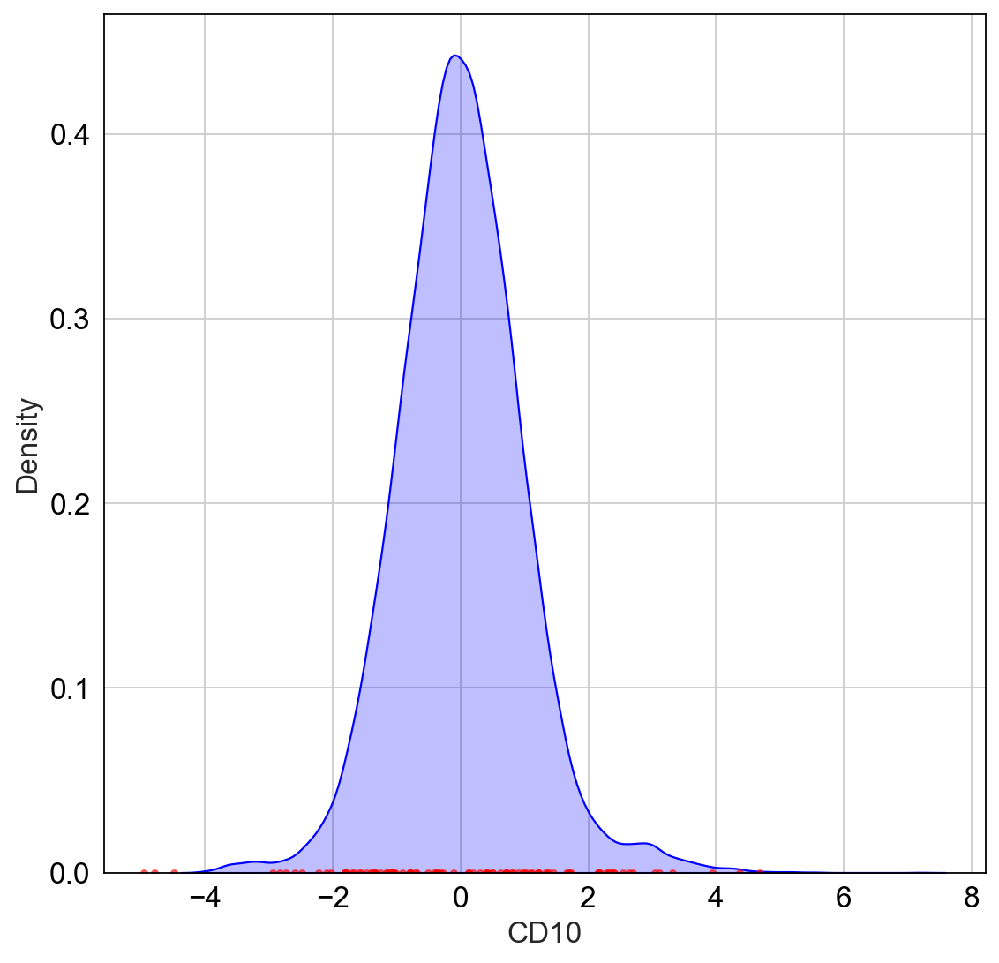

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


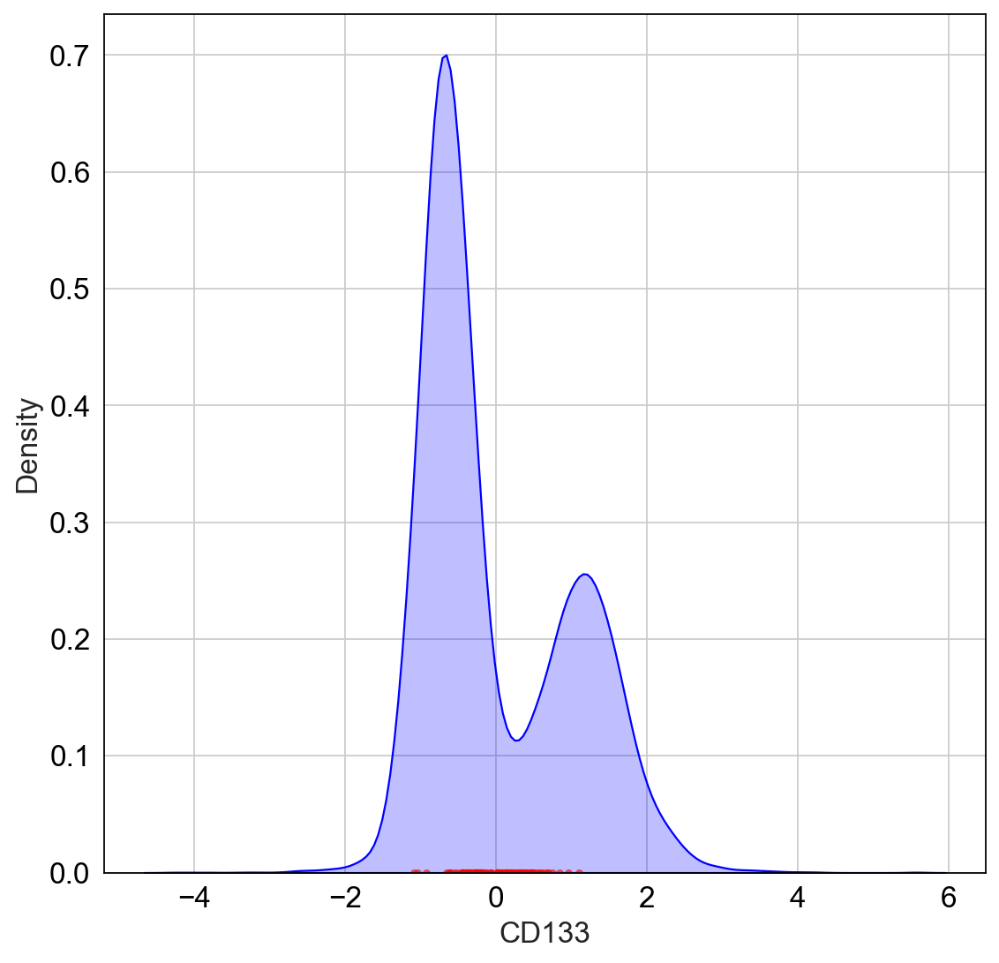

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


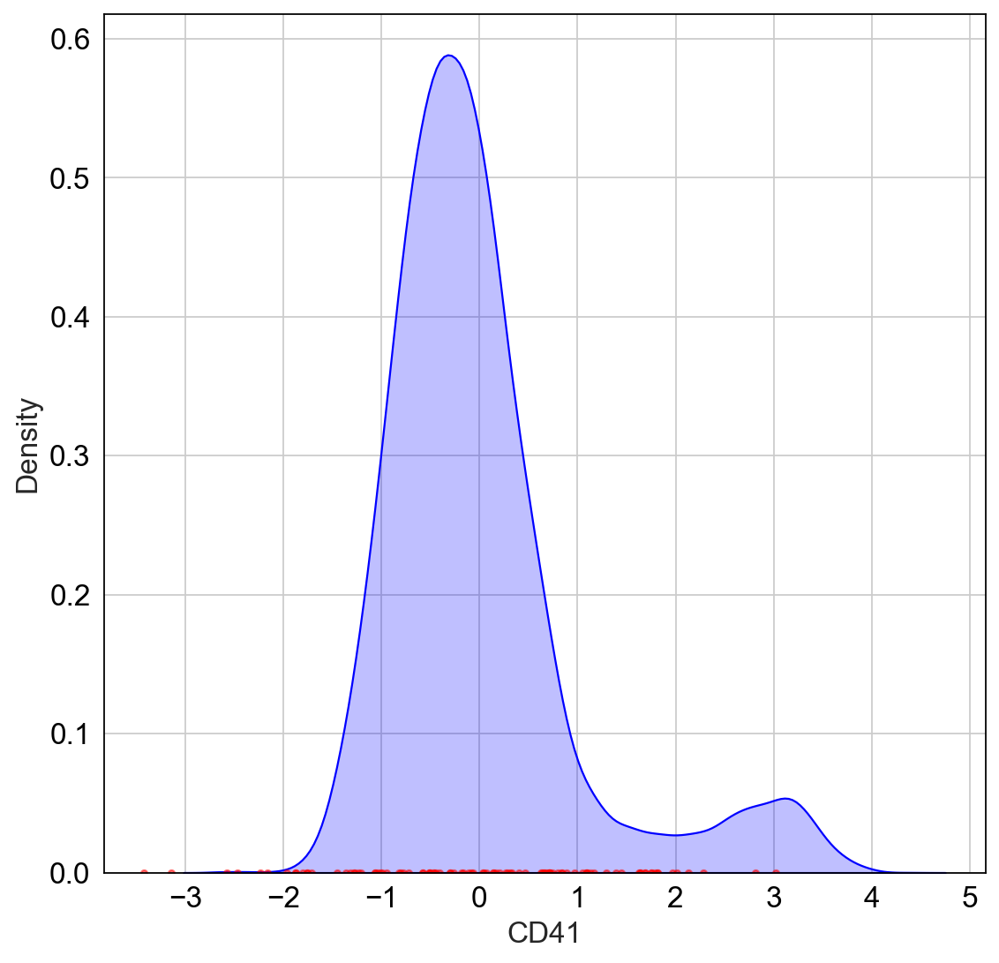

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


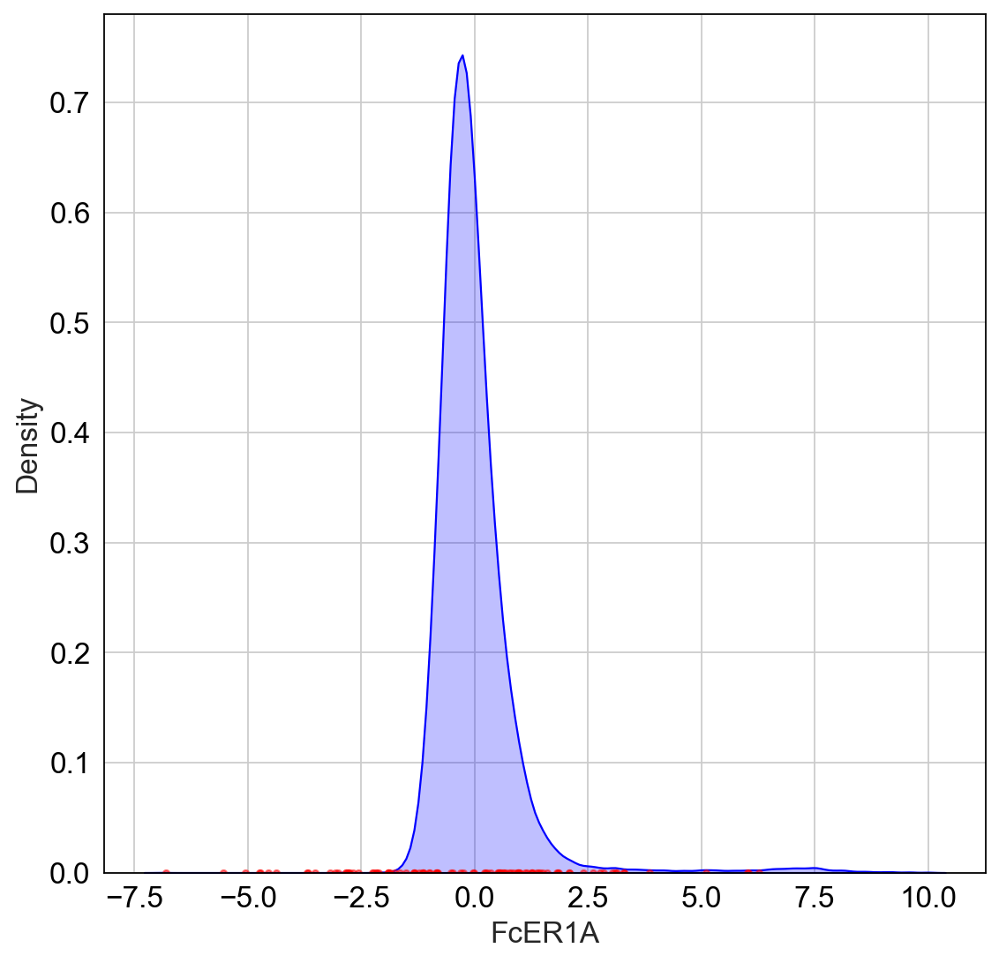

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


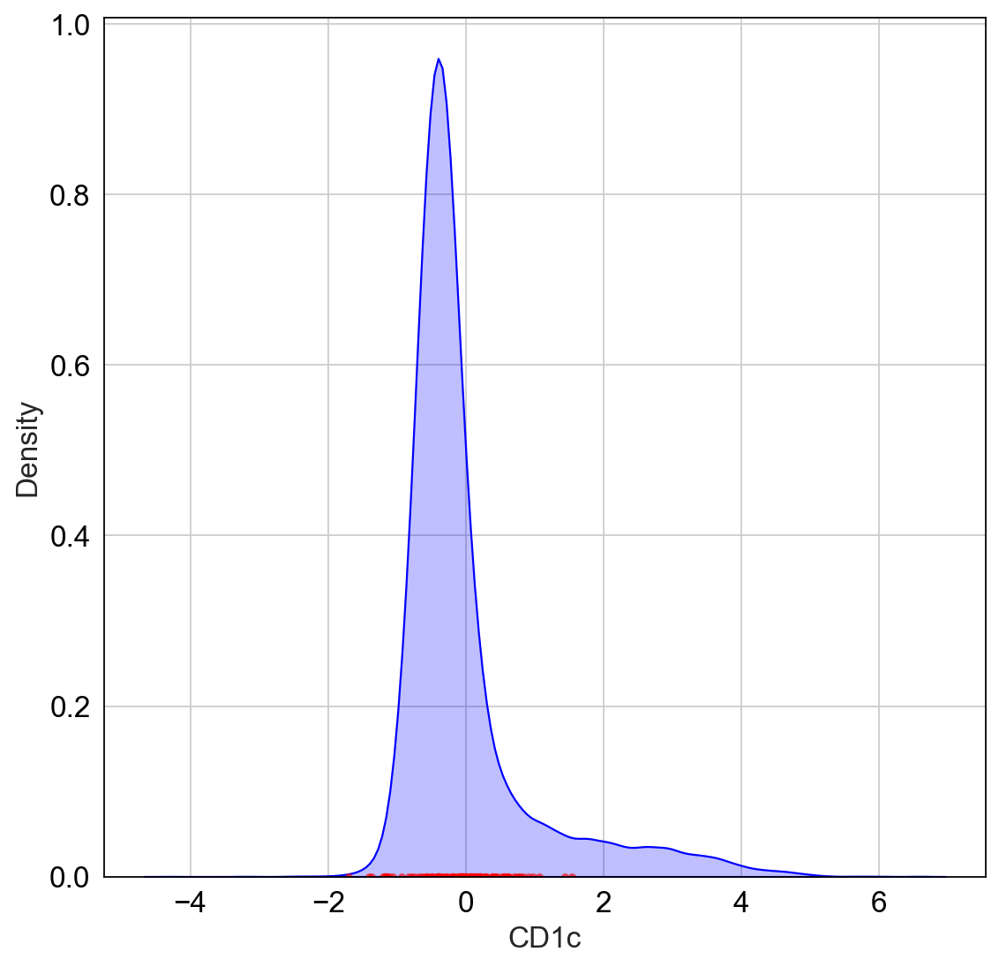

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


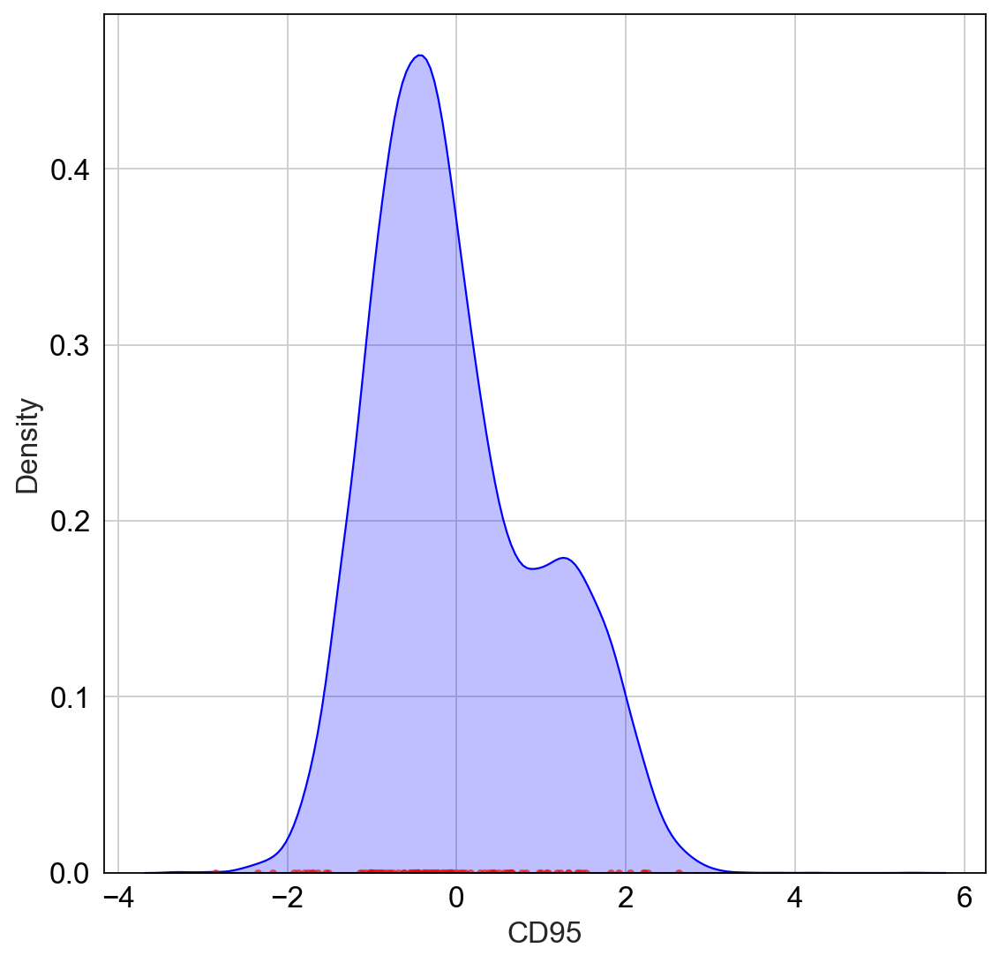

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


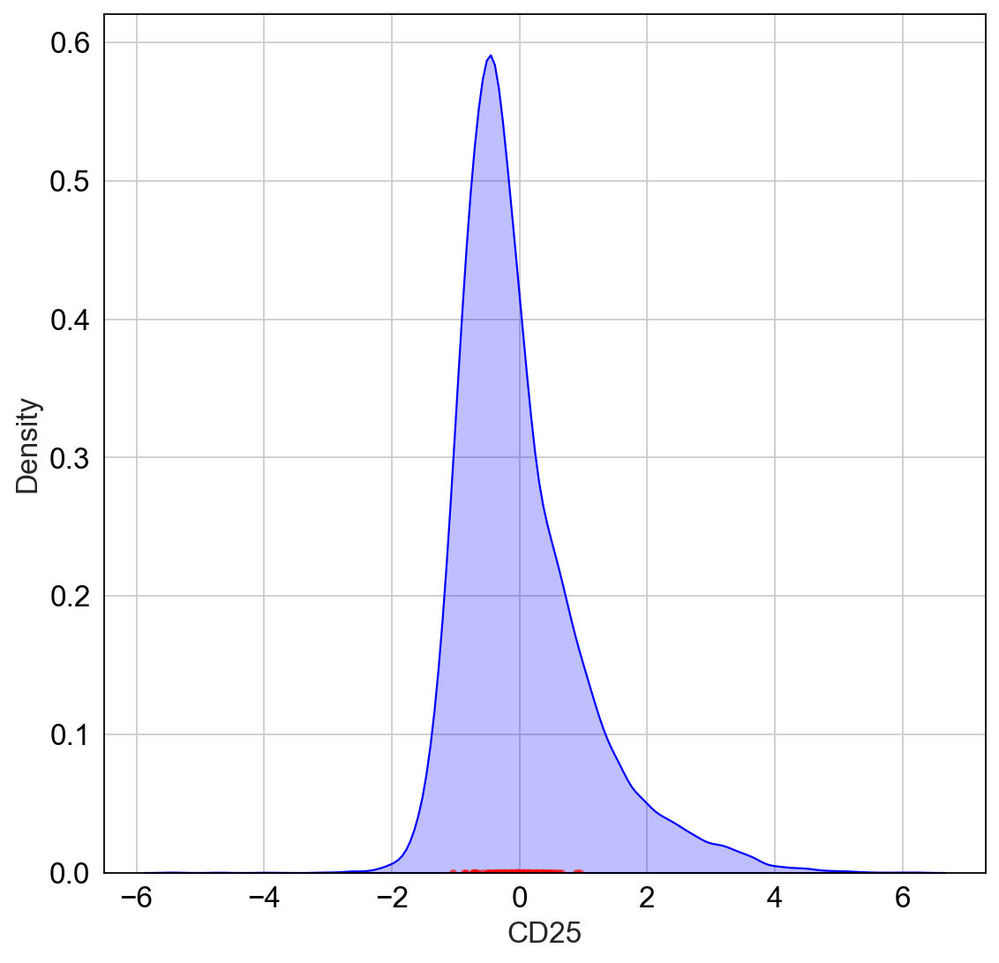

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


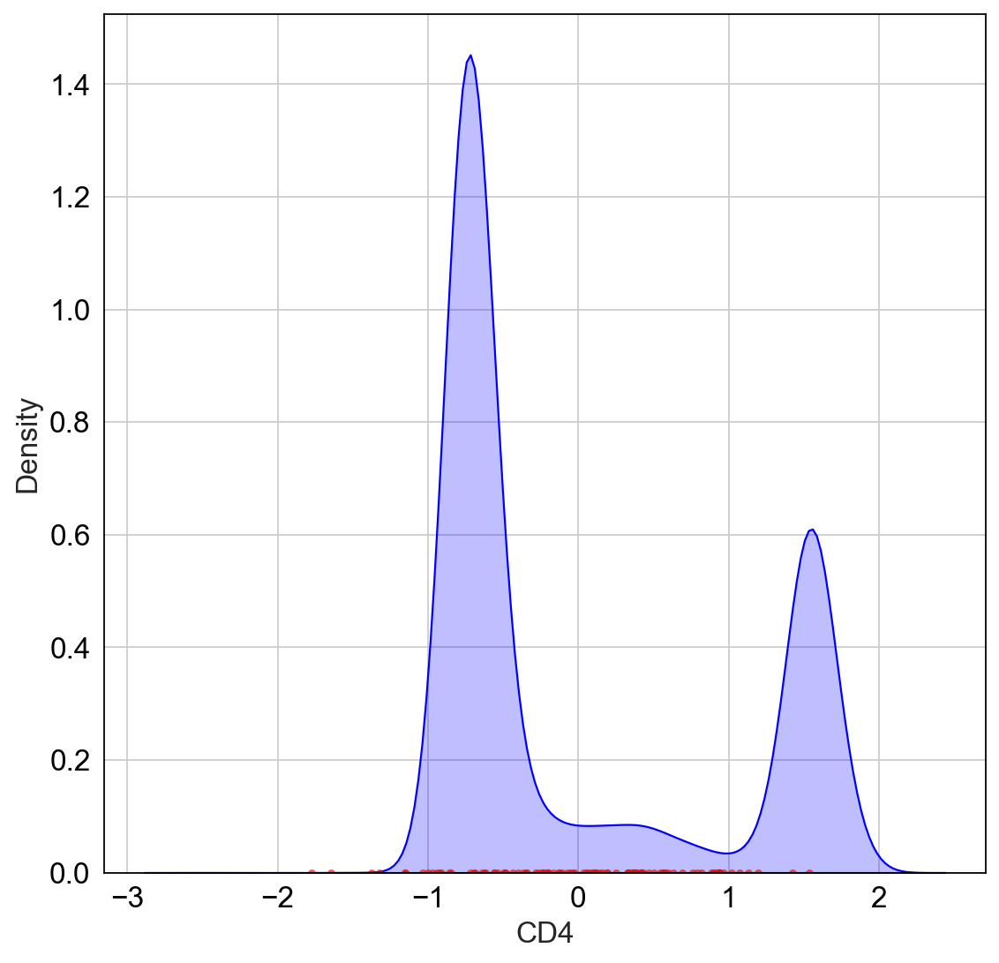

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


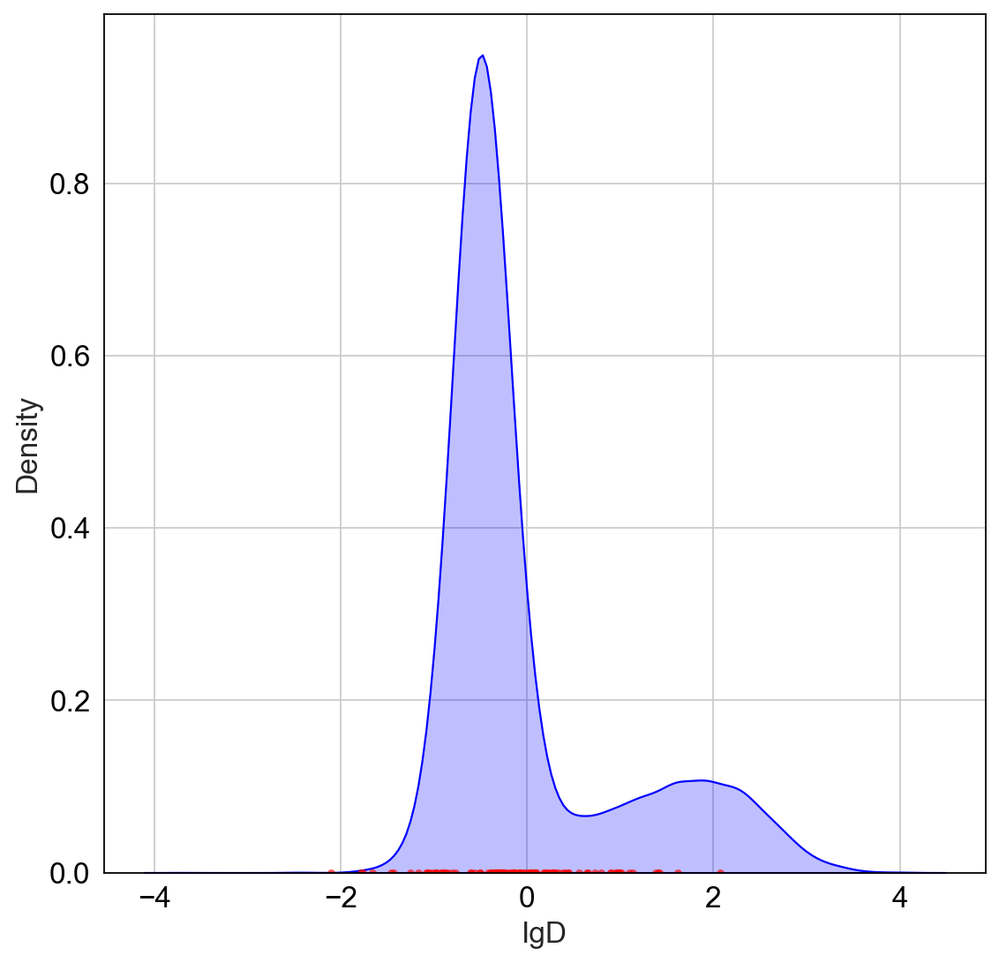

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


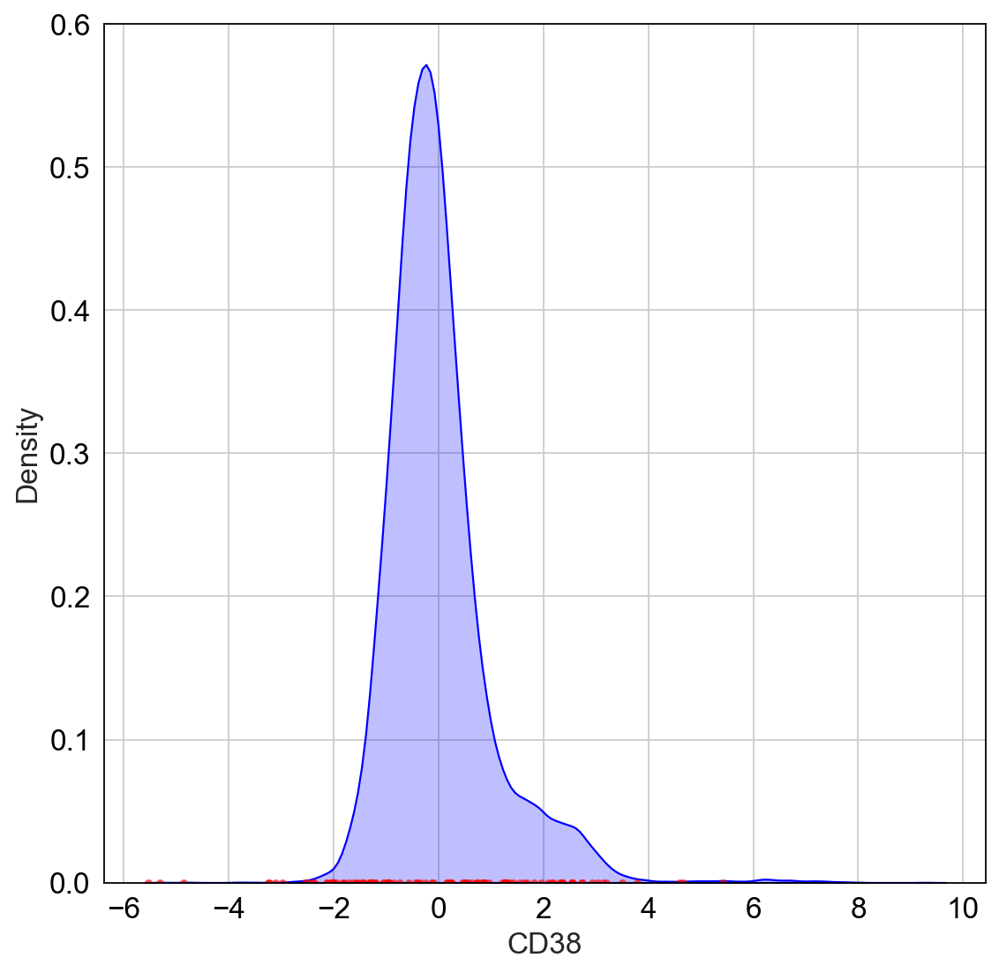

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


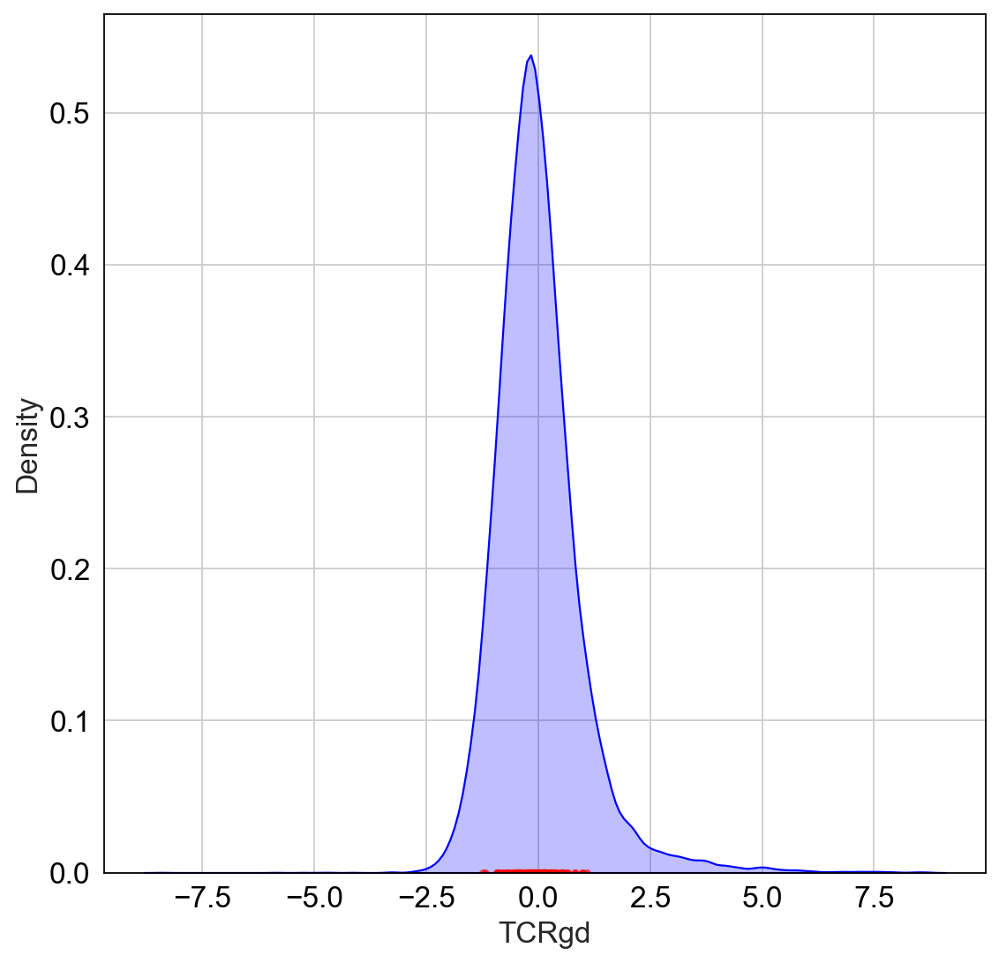

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


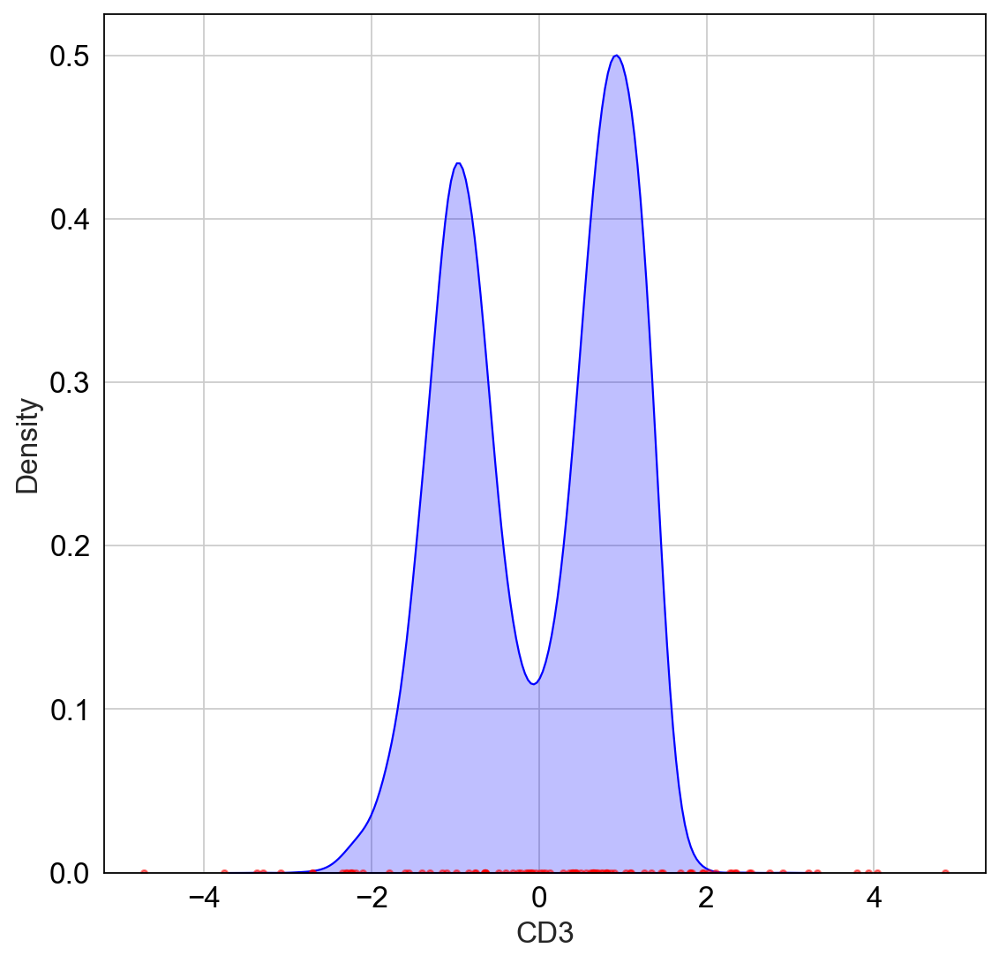

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


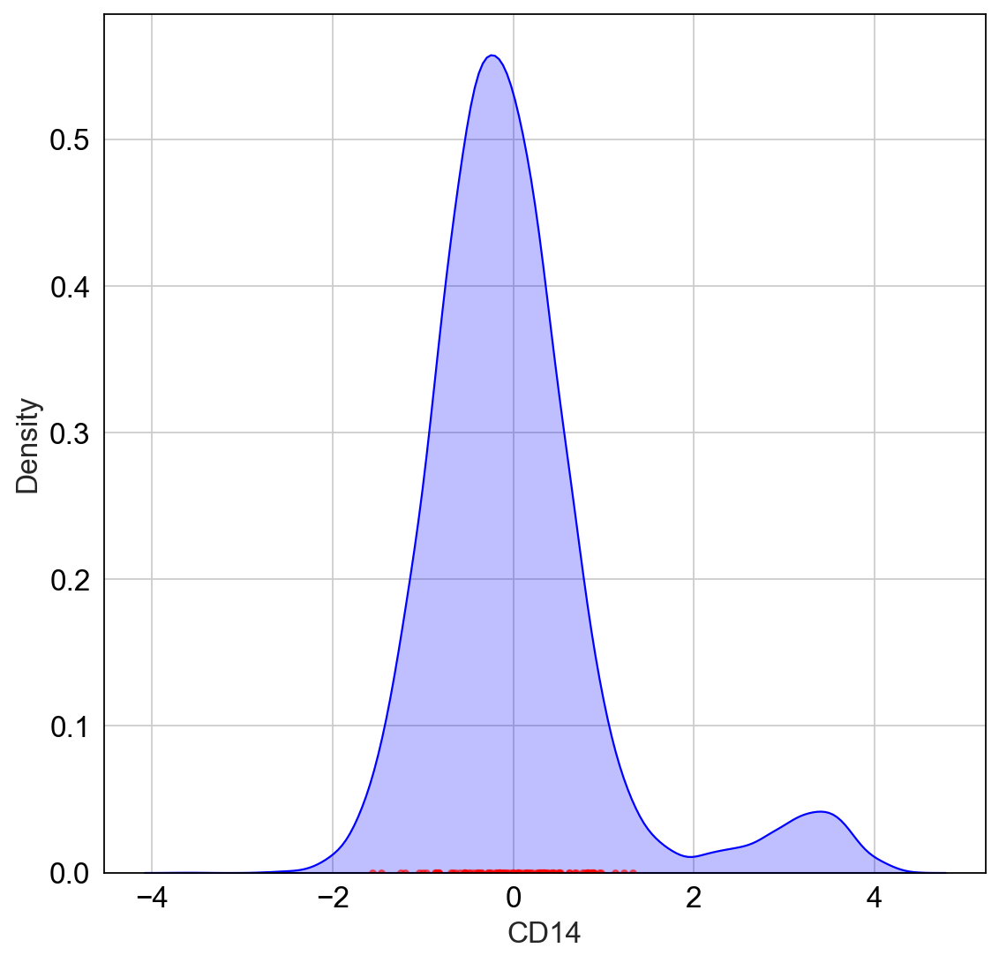

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_32523/3833294006.py:23: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(existing_data[col], shade=True, color='blue')


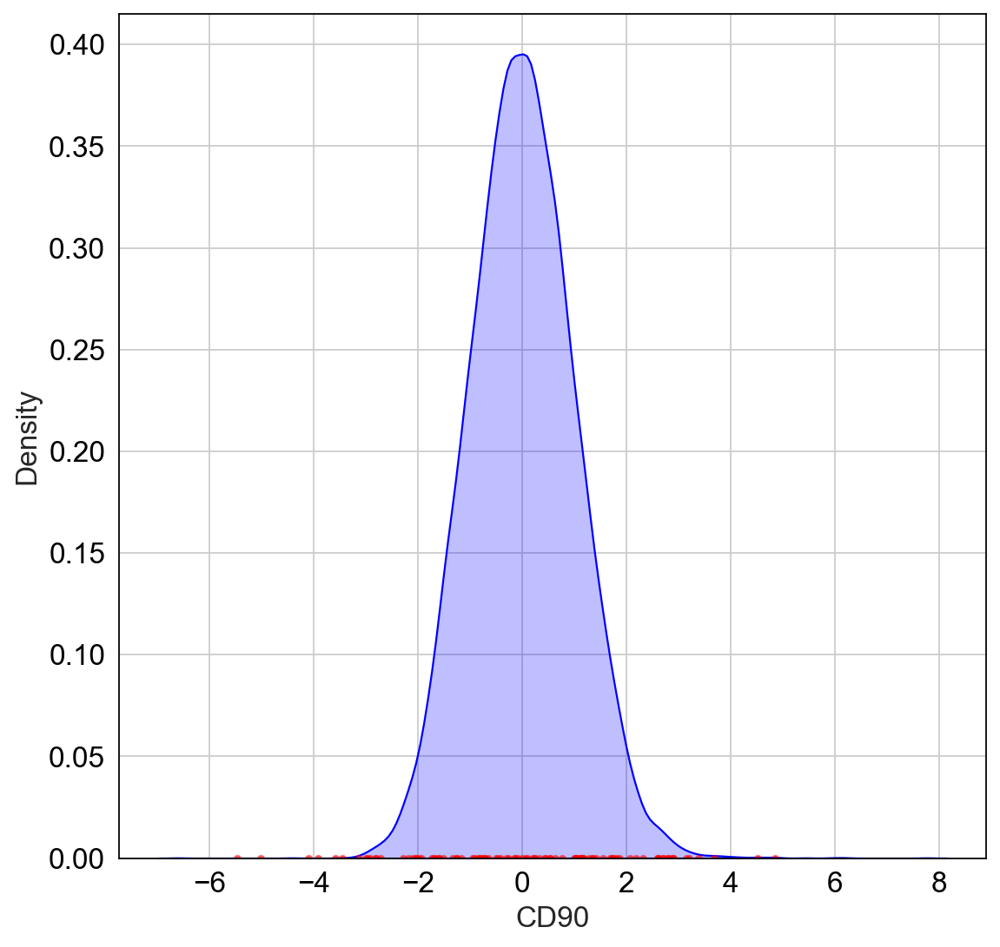

In [20]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the existing data
existing_data = adata.to_df()

# Generate low dim simulation data
low_dim_data = np.random.normal(size=(100, 2))

# Transform low dim data to high dim
high_dim_data = np.dot(low_dim_data, np.random.normal(size=(2, existing_data.shape[1])))

# Convert high dim data to pandas DataFrame
simulation_data = pd.DataFrame(high_dim_data, columns=existing_data.columns)

# Concatenate the existing data and the simulation data
combined_data = pd.concat([existing_data, simulation_data], axis=0)

# Plot the KDE plot of the existing data and simulation points
for col in existing_data.columns:
    sns.kdeplot(existing_data[col], shade=True, color='blue')
    plt.scatter(simulation_data[col], np.zeros_like(simulation_data[col]), color='red', s=10, alpha=0.5)
    plt.xlabel(col)
    plt.show()


/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data[feature], shade=True, ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data[feature], shade=True, ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data[feature], shade=True, ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in fa

/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data[feature], shade=True, ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data[feature], shade=True, ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data[feature], shade=True, ax=axs[i])
/var/folders/b9/mqf9wk292h39196nq6pcyk0jd6kxs7/T/ipykernel_14158/767647990.py:13: FutureWarning: 

`shade` is now deprecated in fa

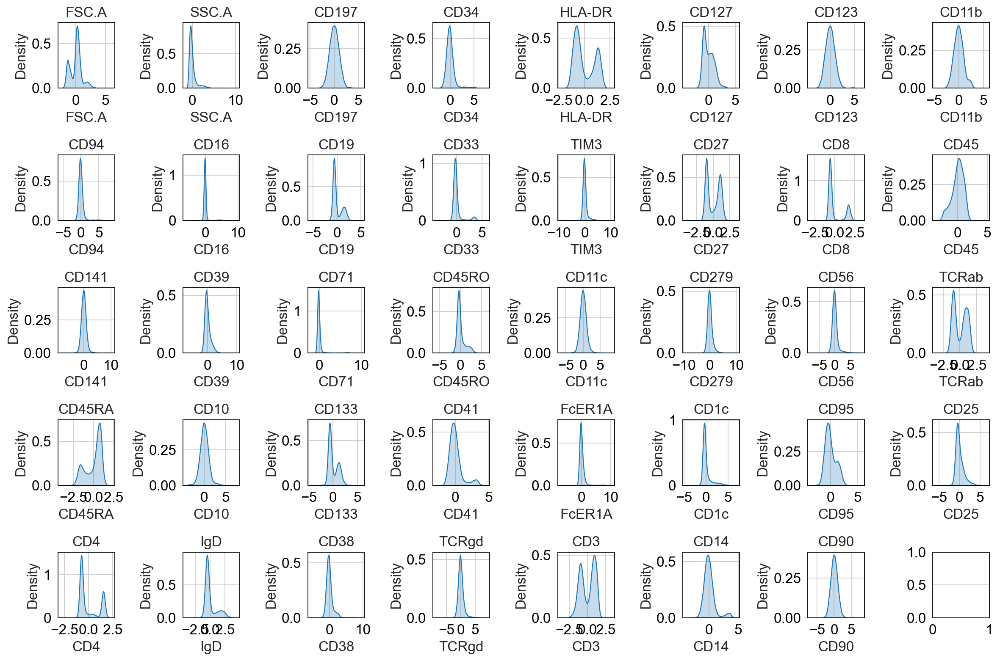

In [18]:
import seaborn as sns
import pandas as pd

# Load some data
data = df

import matplotlib.pyplot as plt

fig, axs = plt.subplots(nrows=5, ncols=8, figsize=(15,10))
axs = axs.ravel()

for i, feature in enumerate(data.columns):
    sns.kdeplot(data[feature], shade=True, ax=axs[i])
    axs[i].set_title(feature)

plt.tight_layout()
plt.show()


In [19]:
# import seaborn as sns

# # Create some data
# data = df[['CD45RA', 'CD19']]

# # Create the heat map of the joint distribution
# sns.jointplot(x="CD45RA", y="CD19", data=data, kind="kde")

# # Show the plot
# plt.show()


In [20]:
# import seaborn as sns

# # Create some data
# data = df[['CD3', 'CD19']]

# # Create the heat map of the joint distribution
# sns.jointplot(x="CD3", y="CD19", data=data, kind="kde")

# # Show the plot
# plt.show()

In [21]:
# import seaborn as sns

# # Create some data
# data = df[['CD45RA', 'CD3']]

# # Create the heat map of the joint distribution
# sns.jointplot(x="CD45RA", y="CD3", data=data, kind="kde")

# # Show the plot
# plt.show()

In [23]:
cluster_key = 'labels'

In [24]:
from FACS_Sampling.preprocessing.utils import set_reference_colors

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


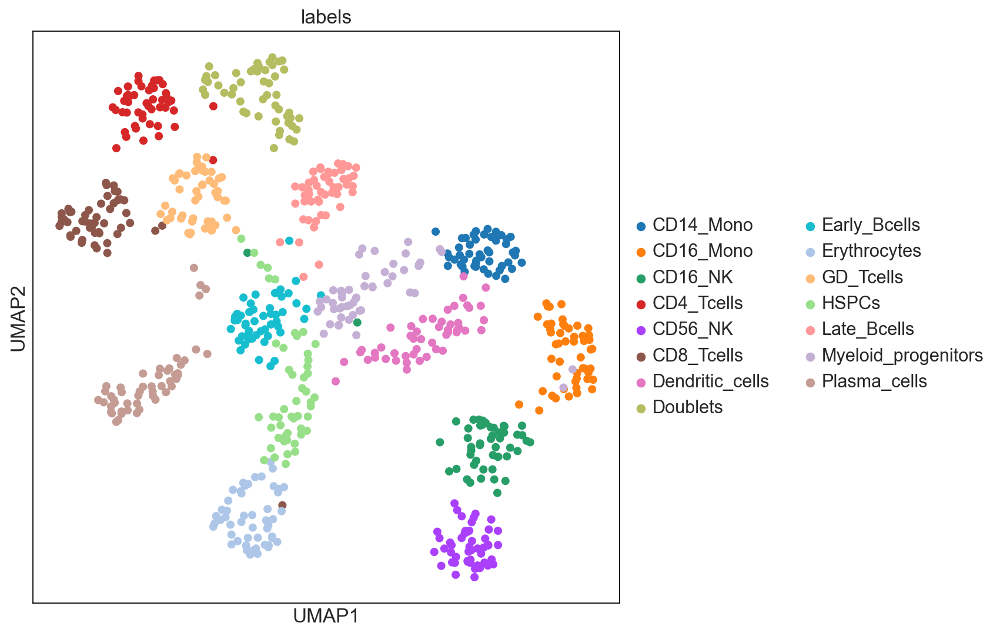

In [25]:
# adata.obs['labels'] = adata.obs['labels'].astype('category')
dictionary = set_reference_colors(adata, cluster_key='labels')


In [26]:
label_key = 'labels'

In [27]:
# ref_adata = adata[ref_s]
ref_adata = adata
change_cmap(ref_adata, dictionary)

### Take the artificial reference 

In [28]:
ref_adata = adata

In [107]:
# corr_s = corr_sampling(ref_adata, sample_per_matrix= 15, rng= 87, seed = 125325)
# corr_s.shape

(5175,)

In [29]:
s_partially_s, _ = bin_sample(ref_adata, n_bins=14, s_size=20)
print(s_partially_s.size)
s_random_s = sample_random(ref_adata, s_size=s_partially_s.size)
s_prop_s, tot = proportional_sampling(ref_adata, n_bins=16, total_size=189, power= 0.01, seed= 12345)



5217


In [109]:
s_prop_s, tot = proportional_sampling(ref_adata, n_bins=16, total_size=189, power= 0.01, seed= 12345)
print(s_prop_s.size)

4781


### Plots

In [110]:
sc.set_figure_params(dpi=300, color_map = 'viridis_r', figsize=(8,8), fontsize=15,)
sc.settings.verbosity = 1
sc.logging.print_header()
# sc.set_figure_params(figsize=(8,8), fontsize=15, )



scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.2 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.9.11 pynndescent==0.5.8


In [111]:
small_random_adata = ref_adata[s_random_s]
change_cmap(small_random_adata, dictionary, celltype_key=label_key)
sc.tl.leiden(small_random_adata, resolution= 2)

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/plotting/plotting.py:7: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  sc.pp.neighbors(adata, n_neighbors = 30)


/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


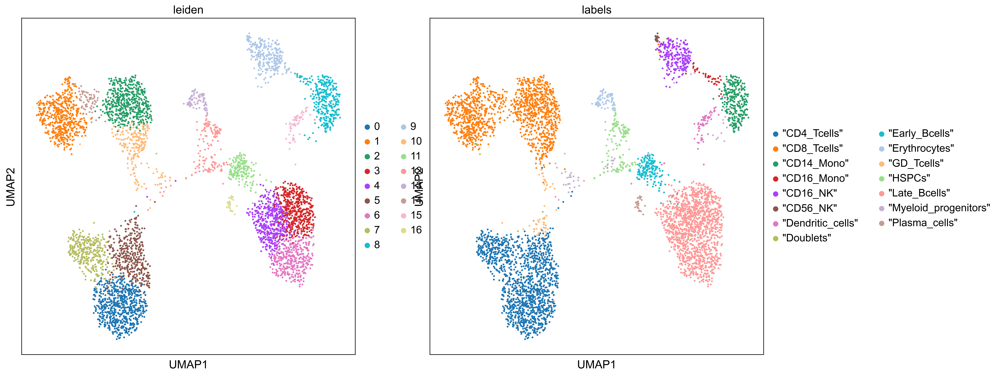

In [112]:
sc.pl.umap(small_random_adata, color=['leiden', label_key], save= "uniform_schayan")

In [113]:
small_partially_adata = ref_adata[s_partially_s]
change_cmapplot_umap(small_partially_adata, dictionary, celltype_key=label_key)
sc.tl.leiden(small_partially_adata, resolution= 2)

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/plotting/plotting.py:7: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  sc.pp.neighbors(adata, n_neighbors = 30)


/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


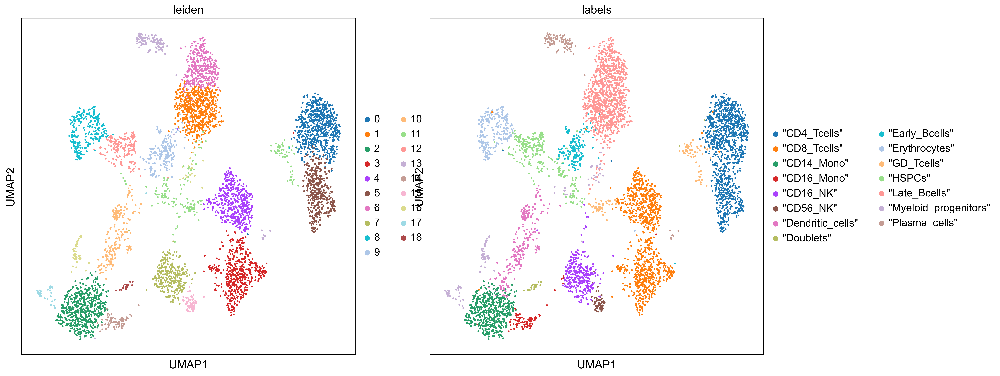

In [114]:
sc.pl.umap(small_partially_adata, color=['leiden', label_key], save='FSBS_schayan')

In [115]:
small_prop_adata = ref_adata[s_prop_s]
change_cmapplot_umap(small_prop_adata, dictionary,celltype_key=label_key)
sc.tl.leiden(small_prop_adata, resolution= 2)

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/plotting/plotting.py:7: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  sc.pp.neighbors(adata, n_neighbors = 30)


/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


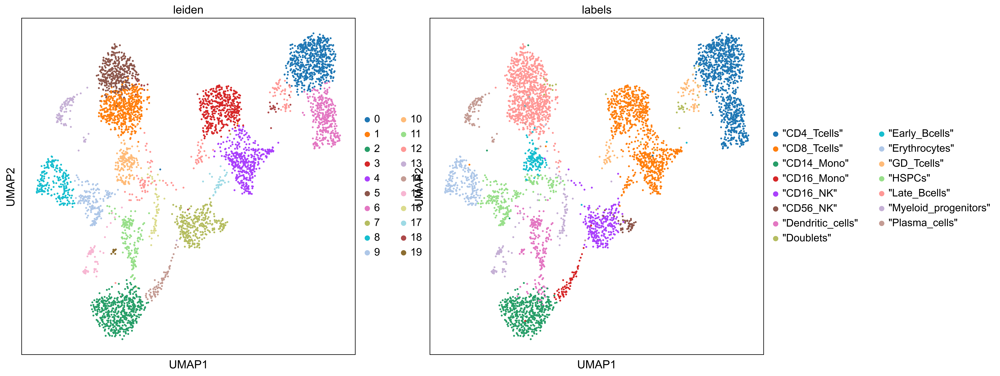

In [116]:
sc.pl.umap(small_prop_adata, color=['leiden', label_key], save="prop")

In [117]:
small_corr_adata = ref_adata[corr_s]
change_cmapplot_umap(small_corr_adata, dictionary, celltype_key=label_key)
sc.tl.leiden(small_corr_adata, resolution= 2)

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/plotting/plotting.py:7: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  sc.pp.neighbors(adata, n_neighbors = 30)


/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


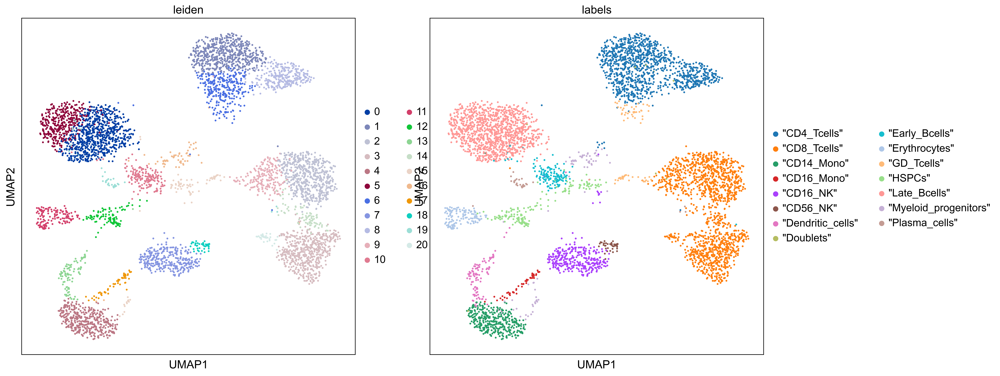

In [118]:
sc.pl.umap(small_corr_adata, color=['leiden', label_key], save="CORR_schayan")

In [265]:
adata.var_names.values

array(['FSC.A', 'SSC.A', 'CD197', 'CD34', 'HLA-DR', 'CD127', 'CD123',
       'CD11b', 'CD94', 'CD16', 'CD19', 'CD33', 'TIM3', 'CD27', 'CD8',
       'CD45', 'CD141', 'CD39', 'CD71', 'CD45RO', 'CD11c', 'CD279',
       'CD56', 'TCRab', 'CD45RA', 'CD10', 'CD133', 'CD41', 'FcER1A',
       'CD1c', 'CD95', 'CD25', 'CD4', 'IgD', 'CD38', 'TCRgd', 'CD3',
       'CD14', 'CD90'], dtype=object)

In [439]:
def kde_plot_genes(adata, n_bins=14, threshold=0.15):
    for count, gene in enumerate(adata.var_names.values, start=1):
        plt.subplot(6,7,count)
        mini = adata[:, [gene]]
        std = np.std(np.array(mini.X))
        mean = np.mean(np.array(mini.X))

        measures = []
        var = (n_bins - 2) / 2
        for i in range(n_bins - 1):
            measures.append(mean - var * std)
            var -= 1

        sns.kdeplot(np.array(mini.X.reshape(-1)), fill=True,)

        for i in range(len(measures)):
            plt.axvline(x=measures[i], color='red', linestyle='--')

        plt.axhline(y=threshold, color='b', linestyle='-')

        plt.title("{}".format(gene))
    plt.savefig("kde_plots_genes.png")

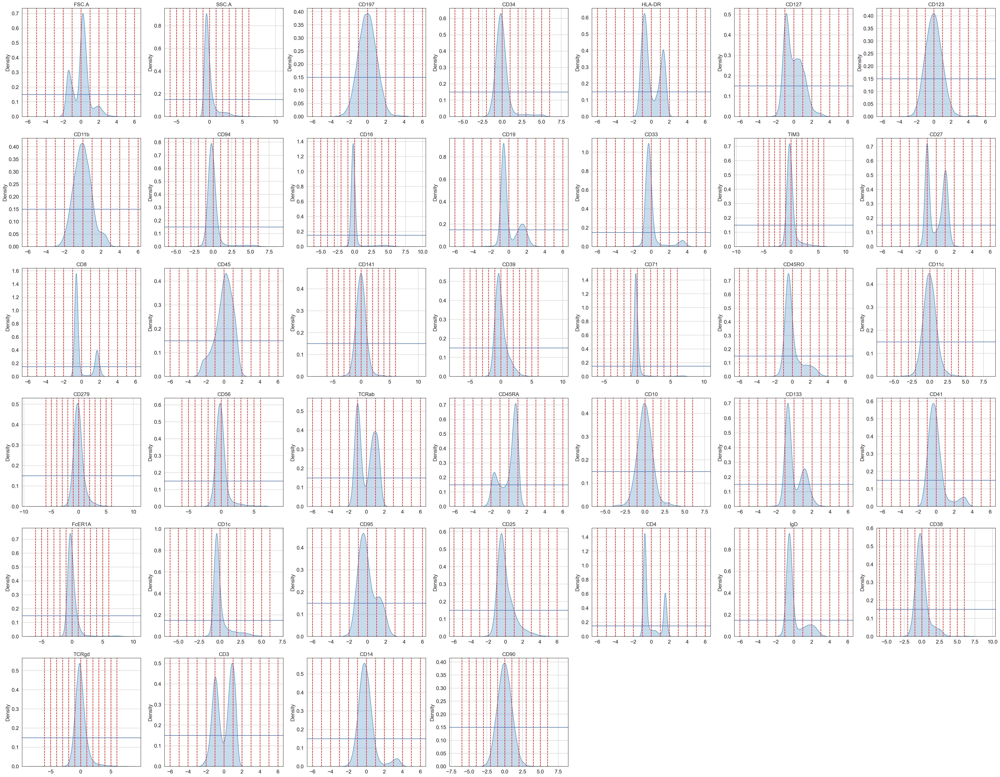

In [440]:
kde_plot_genes(adata)

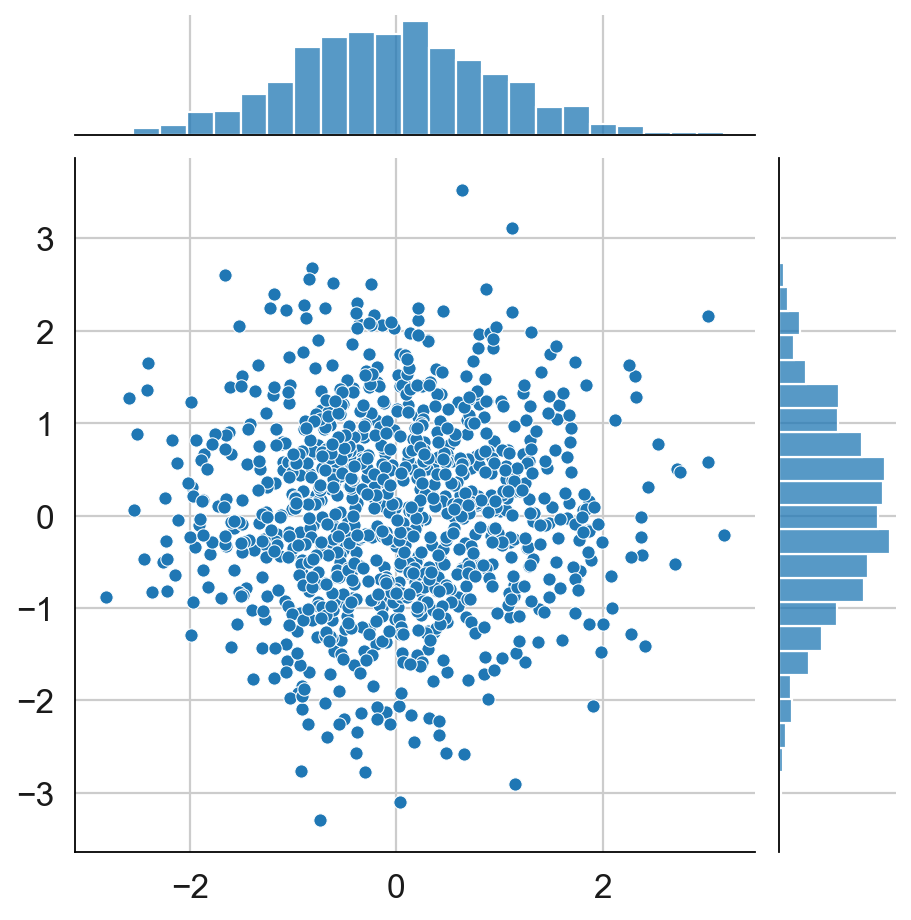

In [456]:
import numpy as np

# Generate 2D Gaussian data
mean = [0, 0]
cov = [[1, 0], [0, 1]]  # diagonal covariance
data = np.random.multivariate_normal(mean, cov, 1000)

sns.jointplot(data, x=data[:, 0], y=data[:, 1], kind='scatter')



/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


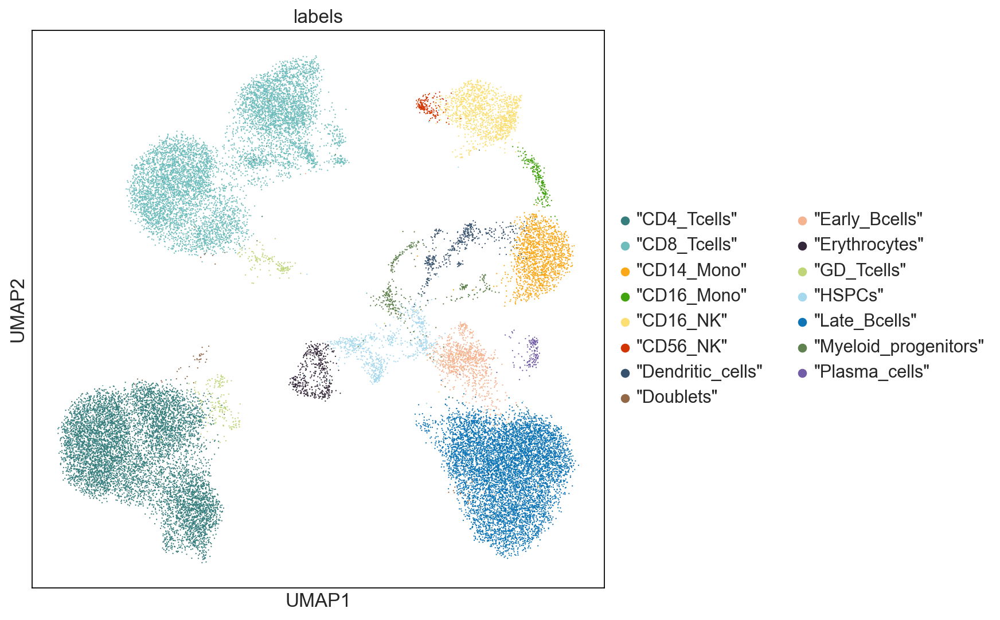

In [676]:
sc.pl.umap(adata, color=label_key)

In [451]:
adata.obs[label_key].value_counts()

"CD4_Tcells"             8008
"CD8_Tcells"             7698
"Late_Bcells"            7415
"CD14_Mono"              1605
"CD16_NK"                1332
"Early_Bcells"            942
"HSPCs"                   756
"Erythrocytes"            471
"Dendritic_cells"         446
"Myeloid_progenitors"     386
"GD_Tcells"               334
"CD16_Mono"               224
"CD56_NK"                 173
"Plasma_cells"            147
"Doublets"                 63
Name: labels, dtype: int64

In [452]:
adata

AnnData object with n_obs × n_vars = 30000 × 39
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Patient', 'FlowSOM_cluster', 'FlowSOM_metacluster', 'RNA_snn_res.0.2', 'RNA_snn_res.0.4', 'RNA_snn_res.0.6', 'RNA_snn_res.0.8', 'RNA_snn_res.1', 'RNA_snn_res.1.2', 'RNA_snn_res.1.4', 'seurat_clusters', 'Cluster_anno', 'labels', 'batch'
    var: 'features'
    uns: 'neighbors', 'umap', 'labels_colors', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

# Simulation

In [43]:
real_data, real_label = adata.obsm['X_pca'], adata.obs[label_key].values
sim_data_size = 1000

In [44]:
extended_labels = pd.concat([pd.Series(real_label), 
                             pd.Series(pd.Categorical(['Sim' for i in range(
                                 sim_data_size)]))])
extended_labels.reset_index(drop=True)

0         CD4_Tcells
1         CD8_Tcells
2        Late_Bcells
3         CD8_Tcells
4        Late_Bcells
            ...     
30995            Sim
30996            Sim
30997            Sim
30998            Sim
30999            Sim
Length: 31000, dtype: object

In [45]:
ad_df = adata.to_df()
generated_data = np.random.normal(size=(sim_data_size, ad_df.shape[1]))
extended_data = pd.concat([ad_df, pd.DataFrame(generated_data, columns=ad_df.columns)])
extended_data['labels'] = extended_labels.values
extended_data = extended_data.reset_index(drop=True)

In [50]:
ext_adata = create_adata(extended_data, obs_features='labels')
dictionary = set_reference_colors(ext_adata, cluster_key='labels', make_plot=False)
sc.tl.pca(ext_adata)

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/preprocessing/utils.py:60: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = sc.AnnData(X, obs=obs, var=var)
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


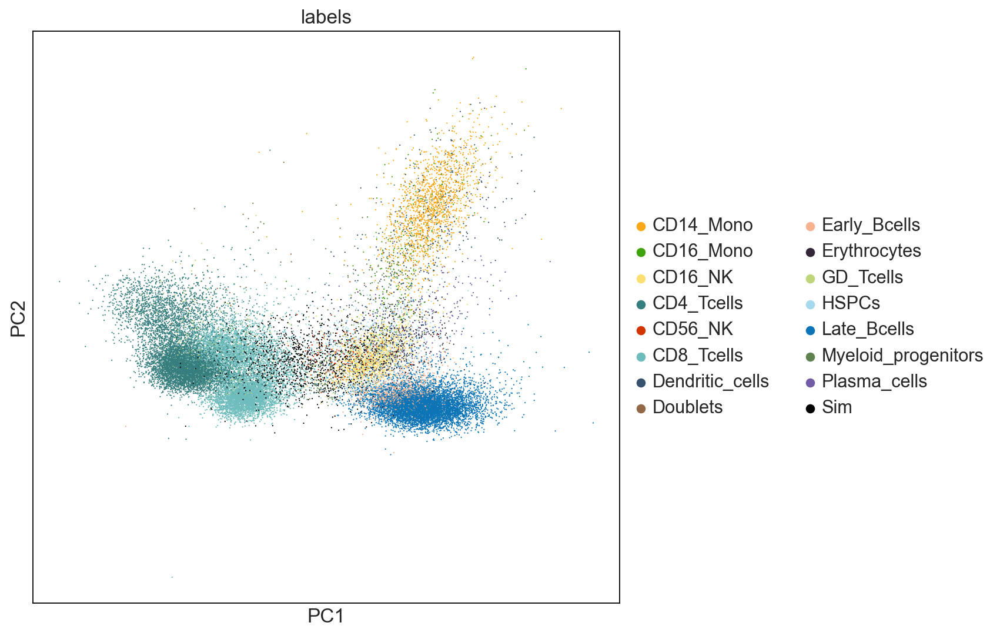

In [51]:
dictionary['Sim'] = '#000000'
change_cmap(ext_adata, dictionary,celltype_key='labels')
sc.pl.pca(ext_adata, color=label_key)

In [ ]:
# plot the umap of original daat with the same pallet
change(adata, dictionary,celltype_key='labels')
sc.pl.pca(adata, color=label_key)

In [652]:
import numpy as np
np.random.seed(1234)
# Generate 2D Gaussian data
mean = [5, -3]
cov = [[0.3, 0], [0, 0.3]]  # diagonal covariance
fake_data = np.random.multivariate_normal(mean, cov, 1000)

# Generate 2D Gaussian data to multiply to the embedding to bring it to high-dim
mean = [0, 0]
cov = [[1, 0], [0, 1]]  # diagonal covariance
factor = np.random.multivariate_normal(mean, cov, adata.shape[1])

# put the generated numbers in their place in ext_adata
ext_adata.obsm['X_umap'][adata.shape[0]:, ] = fake_data

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


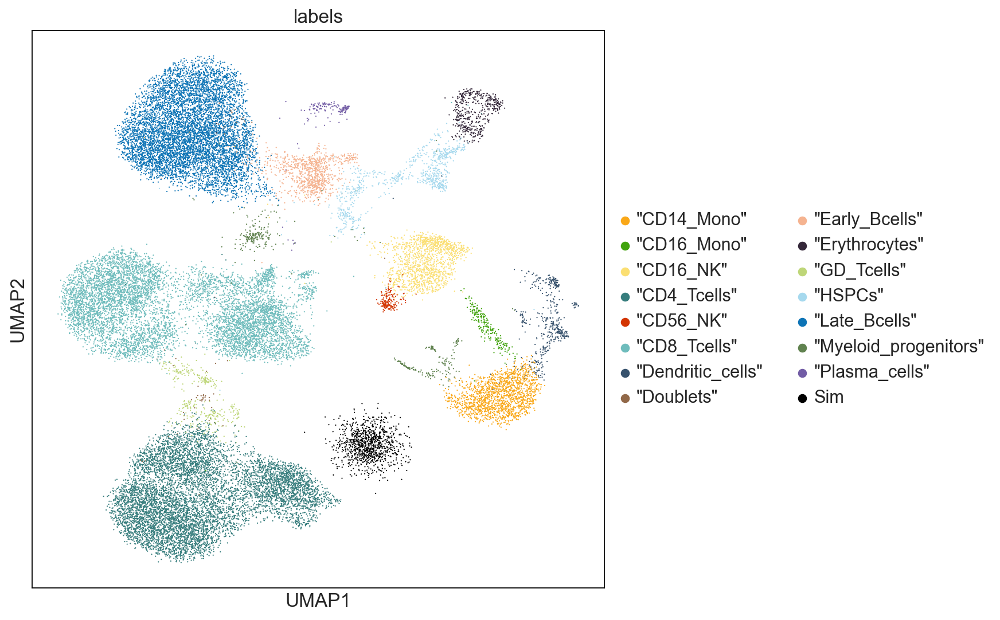

In [653]:
sc.pl.umap(ext_adata, color=label_key)

In [665]:
high_dim_fake = np.matmul(fake_data, factor.T)

In [ ]:
ext_adata.X[adata.shape[0]:,] = high_dim_fake

In [672]:
sc.pp.neighbors(ext_adata)

In [673]:
sc.tl.umap(ext_adata)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


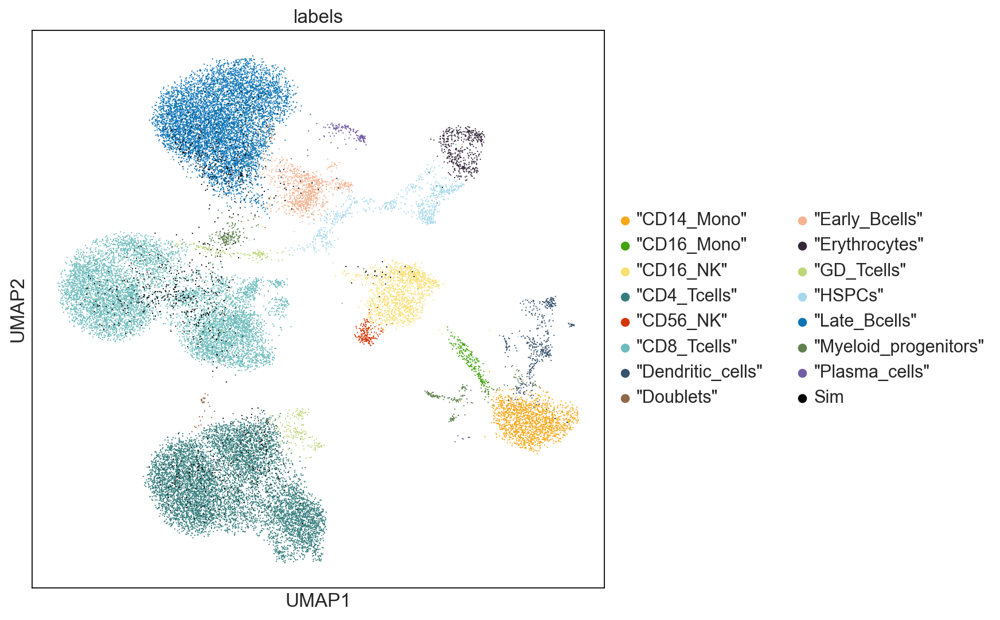

In [675]:
sc.pl.umap(ext_adata, color=label_key)

In [433]:
a = find_bounds(intersections, unit)

In [119]:
cell_type_order = ref_adata.obs[label_key].value_counts().keys().values

In [488]:
generated_label

['Artificial', '"CD8_Tcells"', '"Late_Bcells"', '"CD8_Tcells"', '"Late_Bcells"', ..., '"CD4_Tcells"', '"CD4_Tcells"', '"Late_Bcells"', '"Erythrocytes"', '"CD4_Tcells"']
Length: 30000
Categories (16, object): ['"CD4_Tcells"', '"CD8_Tcells"', '"CD14_Mono"', '"CD16_Mono"', ..., '"Late_Bcells"', '"Myeloid_progenitors"', '"Plasma_cells"', 'Artificial']

### Bootstraping

In [168]:
# from FACS_Sampling.methods.methods import bootstrap

In [127]:
df = bootstrap(ref_adata, rep=40)

KeyError: 'Refined_clustering'

In [128]:
l = df[label_key].unique()

In [131]:
df['method'].unique()

array(['Uniform', 'FSBS', 'Proportional'], dtype=object)

In [145]:
m1 = df[df['method'].isin(['Random'])]
m2 = df[df['method'].isin(['FSBS'])]
m3 = df[df['method'].isin(['Proportional'])]

In [136]:
sns.set(font_scale=1.5)


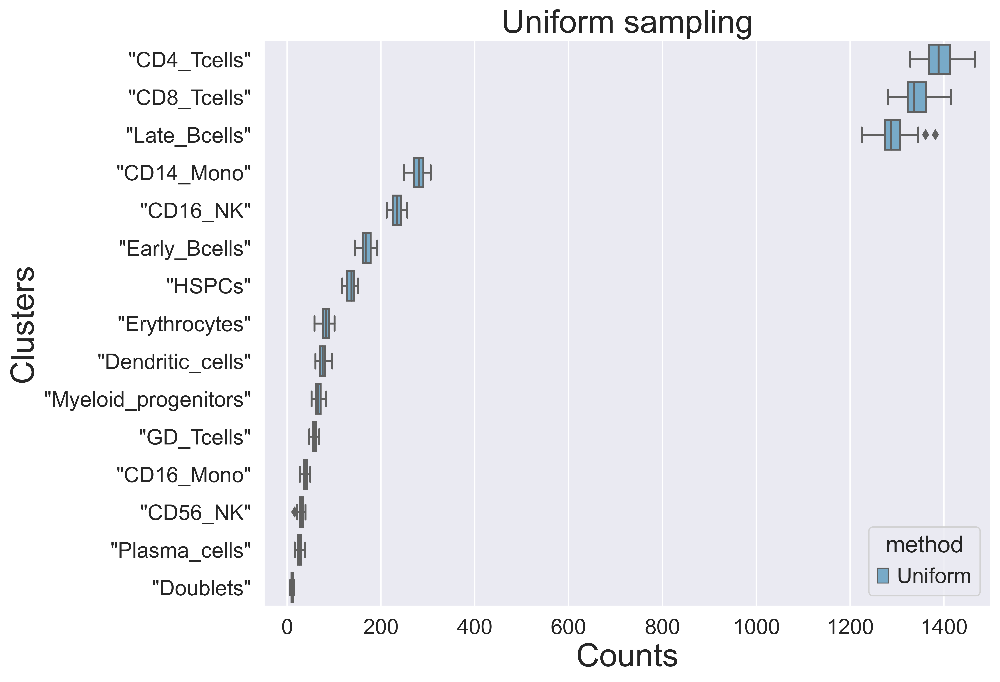

In [141]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y=label_key, x="count", hue='method',data=m1, orient='h', order= cell_type_order, palette="Blues")
plt.xlim(-50, 1500)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Random sampling", size= 25)
plt.savefig("Random.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [142]:
# m2['method'] = "Fixed_size_bin_sampling"

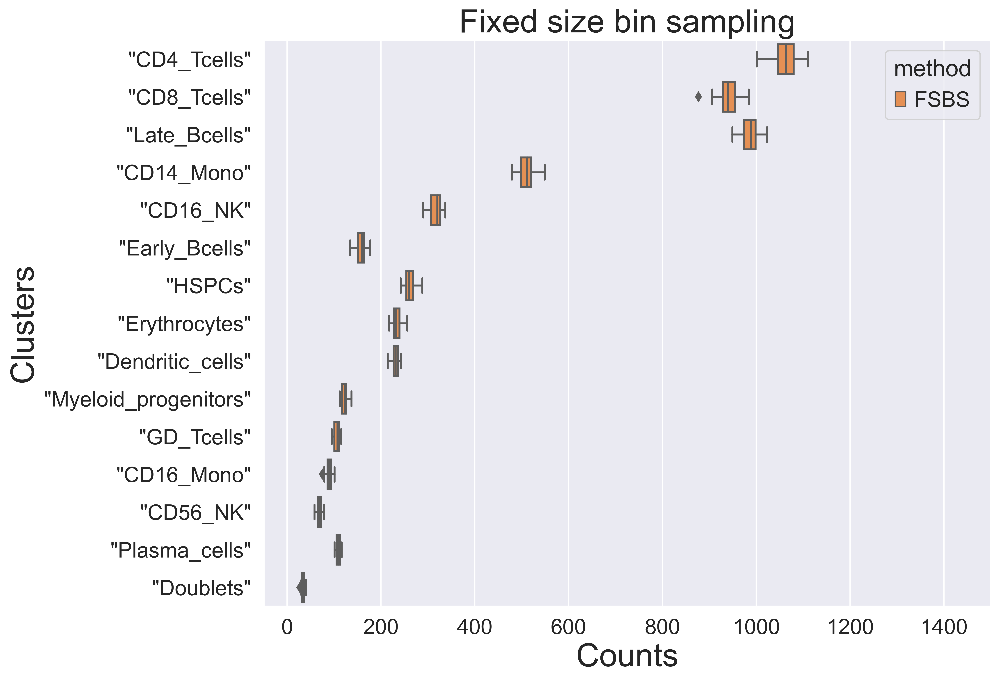

In [146]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y=label_key, x="count", hue='method',data=m2, orient='h', order= cell_type_order, palette='Oranges')
plt.xlim(-50, 1500)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("FSB sampling",  size= 25)
plt.savefig("Fixed_size_bin_sampling.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [147]:
# m3['batch'] = "Proportional_per_bin_counts"

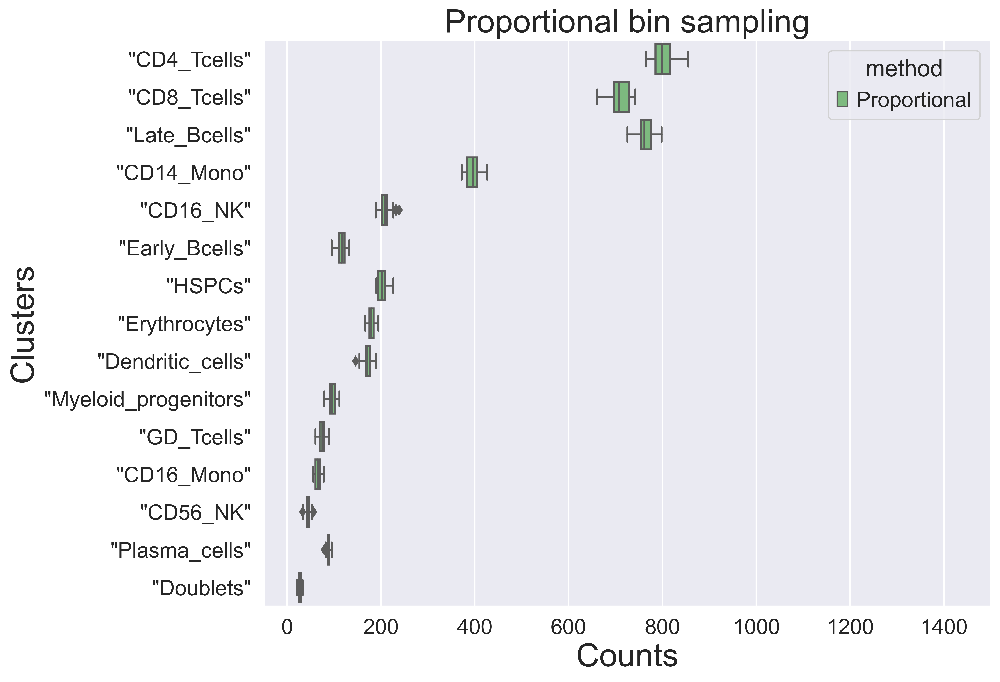

In [148]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y=label_key, x="count", hue='method',data=m3, orient='h', order= cell_type_order, palette="Greens")
plt.xlim(-50, 1500)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Proportional bin sampling",  size= 25)
plt.savefig("Proportional_per_bin_counts.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [43]:
# plt.figure(figsize=(10, 8))
# g = sns.boxplot(x="Refined_clustering", y="count", hue='batch',data=sub_df2, )
# plt.xticks(rotation=90)
# # plt.ylabel("Salary in US Dollars", size=14)
# plt.xlabel("Refined_clustering",size=14)
# plt.title("Subsampling of TCell panel_part2", size=18)
# # plt.savefig("grouped_boxplot_Seaborn_boxplot_Python.png")

In [44]:
# plt.figure(figsize=(10, 8))
# g = sns.boxplot(x="Refined_clustering", y="count", hue='batch',data=sub_df3, )
# plt.xticks(rotation=90)
# # plt.ylabel("Salary in US Dollars", size=14)
# plt.xlabel("Refined_clustering",size=14)
# plt.title("Subsampling of TCell panel_part3", size=18)
# # plt.savefig("grouped_boxplot_Seaborn_boxplot_Python.png")

In [45]:
# plt.figure(figsize=(10, 8))
# g = sns.boxplot(x="Refined_clustering", y="count", hue='batch',data=sub_df4, )
# plt.xticks(rotation=90)
# # plt.ylabel("Salary in US Dollars", size=14)
# plt.xlabel("Refined_clustering",size=14)
# plt.title("Subsampling of TCell panel_part4", size=18)
# # plt.savefig("grouped_boxplot_Seaborn_boxplot_Python.png")

In [181]:
ps.size, rs.size

(5273, 5273)

### Check the MNN

In [193]:
from scipy.spatial import cKDTree

def find_mutual_nn(data1, data2, k1, k2):
    # we consider data1 as train data (sampled data) and data2 as test data (whole data)
    k_index_1 = cKDTree(data1).query(x=data2, k=k1)[1]
    k_index_2 = cKDTree(data2).query(x=data1, k=k2)[1]
    mutual_1 = []
    mutual_2 = []
    for index_2 in range(data2.shape[0]):
        for index_1 in k_index_1[index_2]:
            if index_2 in k_index_2[index_1]:
                mutual_1.append(index_1)
                mutual_2.append(index_2)

    return mutual_1, mutual_2

def clean(mutual_1, mutual_2, train_labels):
    dictionary = dict()
    for i in range(len(mutual_2)):
        if mutual_2[i] not in dictionary.keys():
            dictionary[mutual_2[i]] = [train_labels[mutual_1[i]]]
        else:
            dictionary[mutual_2[i]].append(train_labels[mutual_1[i]])

    return dictionary


In [240]:
def get_mnn_classification_report(index_subset, ref_adata, label_key='labels'):
    small_adata = ref_adata[index_subset]
    bad_inds = small_adata.obs.index
    bad_df = ref_adata.obs.index.isin(bad_inds)

    X_train = small_adata.X
    y_train = small_adata.obs[label_key]
    X_test = ref_adata[~bad_df].X
    y_test = ref_adata[~bad_df].obs[label_key]

    y_pred = MNN_classifier(X_train, X_test, y_train, k=100)

    cr = classification_report(y_test, y_pred, output_dict=True)
    df_cr = pd.DataFrame(cr)
    return df_cr

def MNN_classifier(train_data, test_data, train_labels, k=100):
    mutual_1, mutual_2 = find_mutual_nn(train_data, test_data, k1=k, k2=k)
    dictionary = clean(mutual_1, mutual_2, train_labels)
    y_pred = []
    not_found = []

    clf = neighbors.KNeighborsClassifier(n_neighbors=5)
    clf.fit(train_data, train_labels)

    for i in range(test_data.shape[0]):
        if i in dictionary.keys():
            label = max(set(dictionary[i]), key=dictionary[i].count)
        else:
            label = clf.predict(test_data[i].reshape(1, -1))[0]
            not_found.append(i)
        y_pred.append(label)
    print("{} cells could not get MNN's in the other datasets.".format(len(not_found)))

    return y_pred

In [196]:
# big_data, small_data, k1, k2 = adata[ps].X, adata[rs].X, 200, 200
# get_mnn_classification_report(index_subset, ref_adata, label_key='labels'):

train_data=adata[ps].X
test_data=adata[rs].X
train_labels=adata[ps].obs[label_key]
k=100

mutual_1, mutual_2 = find_mutual_nn(train_data, test_data, k1=k, k2=k)

In [241]:
y_pred = MNN_classifier(train_data, test_data, train_labels, k)

7 cells could not get MNN's in the other datasets.


In [232]:
test_labels=adata[rs].obs[label_key]

lis = ['"Late_Bcells"', '"CD8_Tcells"', '"Late_Bcells"',
       '"CD4_Tcells"', '"CD4_Tcells"', '"HSPCs"', '"Late_Bcells"',
       '"Late_Bcells"', '"CD16_NK"', '"CD8_Tcells"', '"CD8_Tcells"']

In [243]:
print(classification_report(test_labels, y_pred))

                       precision    recall  f1-score   support

          "CD14_Mono"       0.98      0.98      0.98       299
          "CD16_Mono"       0.97      0.90      0.93        39
            "CD16_NK"       0.95      0.99      0.97       215
         "CD4_Tcells"       1.00      0.99      1.00      1407
            "CD56_NK"       0.94      0.88      0.91        34
         "CD8_Tcells"       1.00      0.99      0.99      1352
    "Dendritic_cells"       0.99      0.94      0.96        85
           "Doublets"       0.78      0.88      0.82         8
       "Early_Bcells"       0.99      0.93      0.96       154
       "Erythrocytes"       0.97      0.99      0.98        88
          "GD_Tcells"       0.88      0.97      0.92        60
              "HSPCs"       0.89      0.99      0.93       137
        "Late_Bcells"       1.00      1.00      1.00      1308
"Myeloid_progenitors"       0.82      0.85      0.83        62
       "Plasma_cells"       0.89      1.00      0.94  

In [197]:
dictionary = clean(mutual_1, mutual_2, train_labels)

In [214]:
y_pred =[]
not_found = []

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(train_data, train_labels)

for i in range(test_data.shape[0]):
    if i in dictionary.keys():
        label = max(set(dictionary[i]), key=dictionary[i].count)
    else:
        label = clf.predict(test_data[i].reshape(1,-1))
        not_found.append(i)
    y_pred.append(label)

In [215]:
not_found.__len__()

7

In [209]:
test_data.shape

(5273, 39)

In [213]:
test_data[i].reshape(1,-1).shape

(1, 39)

### KNN for label transfer

In [150]:
from sklearn import neighbors
from sklearn.metrics import classification_report

def training(index_subset, ref_adata, label_key='labels'):
    small_adata = ref_adata[index_subset]
    bad_inds = small_adata.obs.index
    bad_df = ref_adata.obs.index.isin(bad_inds)
    
    X_train = small_adata.X
    y_train = small_adata.obs[label_key]
    X_test = ref_adata[~bad_df].X
    y_test = ref_adata[~bad_df].obs[label_key]

    clf = neighbors.KNeighborsClassifier(n_neighbors=5)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)


    cr = classification_report(y_test, y_pred, output_dict=True)
    df_cr = pd.DataFrame(cr)
    return df_cr

In [151]:
def repeat_knn(ref_adata, label_key='labels', rep = 5, seed=12345):
    np.random.seed(seed)
    output_random = []
    output_fsbs = []
    output_pbs = []
    
    groupped_df = pd.DataFrame(data=None, columns=["count", label_key, "method"])
    for i in range(rep):
        new_seed = np.random.randint(10675)
        
        ps,_ = bin_sample(ref_adata, n_bins=14, s_size=20, seed=new_seed)
        rs = sample_random(ref_adata, s_size=ps.size, seed=new_seed)
        prop_s, _ = proportional_sampling(ref_adata, n_bins=14, total_size=150, power= 0.01, seed= new_seed)
        
        output_random.append(training(rs, ref_adata))
        output_fsbs.append(training(ps, ref_adata))
        output_pbs.append(training(prop_s, ref_adata))
    return output_random, output_fsbs, output_pbs

In [152]:
output_random, output_fsbs, output_pbs = repeat_knn(ref_adata)

In [154]:
acc_rand = []
acc_fsbs = []
acc_pbs = []
for i in range(5):
    acc_rand.append(output_random[i]['accuracy'][0])
    acc_fsbs.append(output_fsbs[i]['accuracy'][0])
    acc_pbs.append(output_pbs[i]['accuracy'][0])

In [163]:
new_seed = np.random.randint(10675)

ps,_ = bin_sample(ref_adata, n_bins=14, s_size=20, seed=new_seed)
rs = sample_random(ref_adata, s_size=ps.size, seed=new_seed)
prop_s, _ = proportional_sampling(ref_adata, n_bins=14, total_size=150, power= 0.01, seed= new_seed)

In [164]:
training(rs, ref_adata)

,"""CD14_Mono""","""CD16_Mono""","""CD16_NK""","""CD4_Tcells""","""CD56_NK""","""CD8_Tcells""","""Dendritic_cells""","""Doublets""","""Early_Bcells""","""Erythrocytes""","""GD_Tcells""","""HSPCs""","""Late_Bcells""","""Myeloid_progenitors""","""Plasma_cells""",accuracy,macro avg,weighted avg
precision,0.953880,0.994083,0.982238,0.990095,0.969466,0.991400,0.993902,1.000000,0.945946,0.950000,0.973333,0.994889,0.985456,0.975610,1.000000,0.984713,0.980020,0.984773
recall,0.997703,0.908108,0.990152,0.999394,0.913669,0.999055,0.903047,0.363636,0.932741,0.992167,0.799270,0.943457,0.998526,0.740741,0.868852,0.984713,0.890035,0.984713
f1-score,0.975299,0.949153,0.986179,0.994723,0.940741,0.995212,0.946299,0.533333,0.939297,0.970626,0.877756,0.968491,0.991948,0.842105,0.929825,0.984713,0.922732,0.983961
support,1306.000000,185.000000,1117.000000,6601.000000,139.000000,6346.000000,361.000000,55.000000,788.000000,383.000000,274.000000,619.000000,6107.000000,324.000000,122.000000,0.984713,24727.000000,24727.000000


In [165]:
training(ps, ref_adata)

,"""CD14_Mono""","""CD16_Mono""","""CD16_NK""","""CD4_Tcells""","""CD56_NK""","""CD8_Tcells""","""Dendritic_cells""","""Doublets""","""Early_Bcells""","""Erythrocytes""","""GD_Tcells""","""HSPCs""","""Late_Bcells""","""Myeloid_progenitors""","""Plasma_cells""",accuracy,macro avg,weighted avg
precision,0.991007,1.000000,0.975610,0.994398,0.989362,0.996471,0.981481,1.000000,0.962517,0.982906,0.956098,0.954451,0.989162,0.972350,1.000000,0.990213,0.983054,0.990162
recall,0.992793,0.941176,0.996016,0.998414,0.885714,0.997351,0.963636,0.437500,0.930142,0.982906,0.894977,0.964435,0.999218,0.817829,0.861111,0.990213,0.910881,0.990213
f1-score,0.991899,0.969697,0.985707,0.996402,0.934673,0.996910,0.972477,0.608696,0.946053,0.982906,0.924528,0.959417,0.994165,0.888421,0.925373,0.990213,0.938488,0.989920
support,1110.000000,136.000000,1004.000000,6934.000000,105.000000,6794.000000,220.000000,32.000000,773.000000,234.000000,219.000000,478.000000,6394.000000,258.000000,36.000000,0.990213,24727.000000,24727.000000


In [156]:
np.mean(acc_rand) - np.max(acc_rand)

-0.001789474581445294

In [157]:
np.mean(acc_fsbs) - np.max(acc_fsbs)

-0.0010510537197517822

In [158]:
np.mean(acc_pbs) - np.max(acc_pbs)

-0.000711784496804202

In [161]:
acc_pbs

[0.9880221130221131,
 0.9879786457733226,
 0.9884916372564063,
 0.9892828333269312,
 0.9893335379656985]

In [100]:
c1_rand = []
c1_fsbs = []
c1_pbs = []
for i in range(5):
    c1_rand.append(output_random[i]['CD8+ tissue-res mem'][2])
    c1_fsbs.append(output_fsbs[i]['CD8+ tissue-res mem'][2])
    c1_pbs.append(output_pbs[i]['CD8+ tissue-res mem'][2])

In [105]:
np.mean(c1_rand) - np.min(c1_rand)

0.052953278437149365

In [108]:
np.mean(c1_fsbs) - np.max(c1_fsbs)

-0.02847052419067797

In [111]:
np.mean(c1_pbs) - np.max(c1_pbs)

-0.022284628316243893

In [122]:
c2_rand = []
c2_fsbs = []
c2_pbs = []
for i in range(5):
    c2_rand.append(output_random[i]['CD4+ CD103+'][2])
    c2_fsbs.append(output_fsbs[i]['CD4+ CD103+'][2])
    c2_pbs.append(output_pbs[i]['CD4+ CD103+'][2])

In [127]:
np.mean(c2_rand) - np.max(c2_rand)

-0.07264880976333743

In [129]:
np.mean(c2_fsbs) - np.max(c2_fsbs)

-0.03806116080715627

In [131]:
np.mean(c2_pbs) - np.max(c2_pbs)

-0.032247436773752525

In [ ]:

small_partially_adata = ref_adata[s_partially_s]
change_cmapchange_cmapplot_umap(small_partially_adata, dictionary)


In [53]:
bad_inds1 = small_partially_adata.obs.index
bad_inds2 = small_random_adata.obs.index
bad_inds3 = small_prop_adata.obs.index


bad_inds = np.concatenate((bad_inds1, bad_inds2, bad_inds3))

In [54]:
bad_df1 = ref_adata.obs.index.isin(bad_inds1)
bad_df2 = ref_adata.obs.index.isin(bad_inds2)
bad_df3 = ref_adata.obs.index.isin(bad_inds3)

In [65]:
df_cr = training(s_partially_s, ref_adata)

In [69]:
df_cr['accuracy']

precision    0.919666
recall       0.919666
f1-score     0.919666
support      0.919666
Name: accuracy, dtype: float64

In [57]:
X_train1 = small_partially_adata.X
y_train1 = small_partially_adata.obs['Refined_clustering']
X_test1 = ref_adata[~bad_df1].X
y_test1 = ref_adata[~bad_df1].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train1, y_train1)
y_pred1 = clf.predict(X_test1)

from sklearn.metrics import classification_report

cr1 = classification_report(y_test1, y_pred1, output_dict=True)
df_cr1 = pd.DataFrame(cr1).transpose()
print(classification_report(y_test1, y_pred1))

                     precision    recall  f1-score   support

        CD4+ CD103+       0.96      0.93      0.94        27
          CD4+ PD1+       0.84      0.57      0.68       597
    CD4+ Treg cells       0.94      0.89      0.92       472
     CD4+ cytotoxic       0.92      0.91      0.91       496
           CD4+ mem       0.89      0.92      0.91      2990
         CD4+ naive       0.96      0.99      0.97      6596
   CD45RA+ IL7R+ gd       0.90      0.75      0.82        12
   CD45RA- IL7R+ gd       0.84      0.89      0.86        72
      CD8+ CD38+ gd       0.33      0.33      0.33         3
      CD8+ CD38- gd       0.85      0.91      0.88       112
    CD8+ CD39+ PD1+       0.82      0.86      0.84       125
   CD8+ central mem       0.85      0.90      0.87       855
      CD8+ effector       0.88      0.98      0.93      1705
  CD8+ effector mem       0.87      0.66      0.75       817
      CD8+ mem stem       0.74      0.48      0.58       110
         CD8+ naive    

In [60]:
df_cr1.sort_values('support').transpose()['accuracy'][0]

0.919666451347701

In [59]:
X_train2 = small_random_adata.X
y_train2 = small_random_adata.obs['Refined_clustering']
X_test2 = ref_adata[~bad_df2].X
y_test2 = ref_adata[~bad_df2].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train2, y_train2)
y_pred2 = clf.predict(X_test2)

from sklearn.metrics import classification_report
print(classification_report(y_test2, y_pred2))

                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       1.00      0.54      0.70        59
                  CD4+ PD1+ T cells       0.76      0.68      0.72       596
                    CD4+ Treg cells       0.95      0.89      0.92       569
             CD4+ cytotoxic T cells       0.96      0.88      0.92       481
                CD4+ memory T cells       0.91      0.90      0.91      2982
                 CD4+ naive T cells       0.96      0.99      0.97      6222
           CD45RA+ IL7R+ gd T cells       0.79      0.73      0.76        15
           CD45RA- IL7R+ gd T cells       0.91      0.86      0.89       125
              CD8+ CD38+ gd T cells       0.67      0.29      0.40         7
              CD8+ CD38- gd T cells       0.84      0.90      0.87       167
            CD8+ CD39+ PD1+ T cells       0.82      0.89      0.86       167
        CD8+ central memory T cells       0.83      0.86      0.85       87

In [60]:
X_train3 = small_prop_adata.X
y_train3 = small_prop_adata.obs['Refined_clustering']
X_test3 = ref_adata[~bad_df3].X
y_test3 = ref_adata[~bad_df3].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train3, y_train3)
y_pred3 = clf.predict(X_test3)

from sklearn.metrics import classification_report
print(classification_report(y_test3, y_pred3))

                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       0.97      0.83      0.89        35
                  CD4+ PD1+ T cells       0.81      0.62      0.70       599
                    CD4+ Treg cells       0.91      0.93      0.92       467
             CD4+ cytotoxic T cells       0.95      0.86      0.90       508
                CD4+ memory T cells       0.91      0.93      0.92      2994
                 CD4+ naive T cells       0.97      0.99      0.98      6579
           CD45RA+ IL7R+ gd T cells       1.00      0.85      0.92        13
           CD45RA- IL7R+ gd T cells       0.89      0.93      0.91        73
              CD8+ CD38+ gd T cells       0.00      0.00      0.00         3
              CD8+ CD38- gd T cells       0.92      0.94      0.93       118
            CD8+ CD39+ PD1+ T cells       0.85      0.86      0.85       135
        CD8+ central memory T cells       0.85      0.90      0.87       87

### Checking the accuracy on the whole data

In [ ]:
bad_df1 = adata.obs.index.isin(bad_inds1)

X_train1 = small_partially_adata.X
y_train1 = small_partially_adata.obs['Refined_clustering']
X_test1 = adata[~bad_df1].X
y_test1 = adata[~bad_df1].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train1, y_train1)
y_pred1 = clf.predict(X_test1)

from sklearn.metrics import classification_report
print(classification_report(y_test1, y_pred1))

                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       0.92      0.95      0.94      3359
                  CD4+ PD1+ T cells       0.85      0.60      0.70     35271
                    CD4+ Treg cells       0.95      0.92      0.93     33098
             CD4+ cytotoxic T cells       0.96      0.90      0.93     30058
                CD4+ memory T cells       0.88      0.95      0.91    177156
                 CD4+ naive T cells       0.97      0.98      0.98    385857
           CD45RA+ IL7R+ gd T cells       0.90      0.45      0.60       738
           CD45RA- IL7R+ gd T cells       0.88      0.90      0.89      7903
              CD8+ CD38+ gd T cells       0.92      0.25      0.39       511
              CD8+ CD38- gd T cells       0.84      0.92      0.88      8876
            CD8+ CD39+ PD1+ T cells       0.80      0.87      0.83     10282
        CD8+ central memory T cells       0.84      0.89      0.86     5709

In [133]:
bad_df2 = adata.obs.index.isin(bad_inds2)

X_train2 = small_random_adata.X
y_train2 = small_random_adata.obs['Refined_clustering']
X_test2 = adata[~bad_df2].X
y_test2 = adata[~bad_df2].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train2, y_train2)
y_pred2 = clf.predict(X_test2)

from sklearn.metrics import classification_report
print(classification_report(y_test2, y_pred2))

/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       0.94      0.89      0.91      3393
                  CD4+ PD1+ T cells       0.85      0.53      0.65     35281
                    CD4+ Treg cells       0.96      0.89      0.92     33209
             CD4+ cytotoxic T cells       0.94      0.93      0.93     30037
                CD4+ memory T cells       0.88      0.95      0.91    177094
                 CD4+ naive T cells       0.97      0.99      0.98    385464
           CD45RA+ IL7R+ gd T cells       0.00      0.00      0.00       744
           CD45RA- IL7R+ gd T cells       0.87      0.84      0.86      7950
              CD8+ CD38+ gd T cells       0.00      0.00      0.00       514
              CD8+ CD38- gd T cells       0.78      0.91      0.84      8934
            CD8+ CD39+ PD1+ T cells       0.78      0.88      0.83     10319
        CD8+ central memory T cells       0.85      0.89      0.87     5710

/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
